# Whelks and lobsters -- context operator

In [2]:
%display latex
import sys

import sys, os, warnings
from contextlib import contextmanager

@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout


@contextmanager
def suppress_warnings():
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        yield

## The system

In [3]:
R.<x,y> = QQ[]

In [4]:
from lbuc import *

In [5]:
us = [x,y]
k=RIF(0.8); b=RIF(0.6); c=RIF(0.3); e=RIF(0.05); f=RIF(2)
vf = vector([b*x*(RIF(1)-x) - c*x*(k-x)*y,
            -e*y*(RIF(1)+y)+f*x*(k-x)*y])
v0 = [RIF(0.5), RIF(2.0)]
v1 = [RIF(0.4), RIF(2.5)]
v2 = [RIF(1,1.2), RIF(4,6)]

In [6]:
v3 = [RIF(1,1.1), RIF(4,5)]

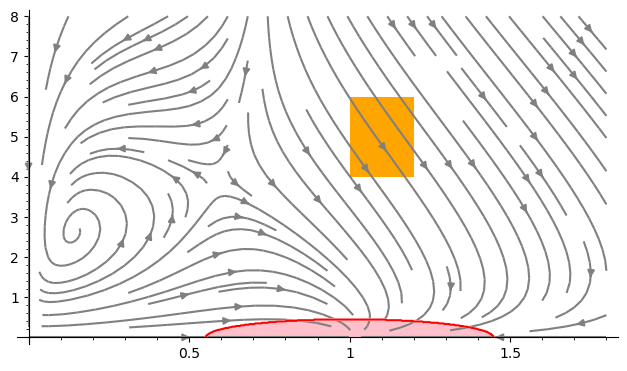

In [7]:
p = streamline_plot(tuple(vf),(x,0,1.8),(y,0,8), color='grey')\
    + polygon([(v2[0].lower(), v2[1].lower()),
               (v2[0].lower(), v2[1].upper()),
               (v2[0].upper(), v2[1].upper()),
               (v2[0].upper(), v2[1].lower())],
              color='orange')\
    + region_plot((lambda x, y: (x - 1)^2 + y^2 - 0.2 < 0),
                  (x, 0, 1.5),
                  (y, 0, 8),
                  incol='pink', plot_points=500, bordercol='red')
#    + point(v0, size=100, marker='X', color='red')\
#    + point(v1, size=100, marker='X', color='green')\
p.set_aspect_ratio(1/8)
p.show()

In [8]:
P = Atomic((x - 1)^2 + y^2 - 0.2)

## Simple signal

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[1.0000000000000000 .. 1.2000000000000000], [4 .. 6]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Computed 501 flowpipes in 1.8237272160040447 sec
PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7fe34ed76820>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=False, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.1000000000

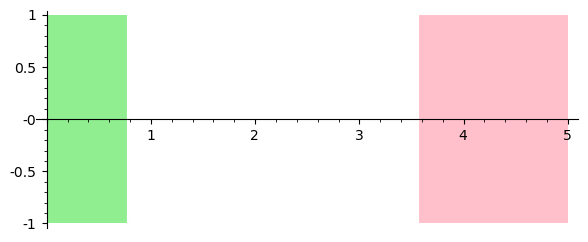

In [9]:
sig = P.signal_for_system(vf, v2, 5, order=5, step=0.01,
                    precondition=1,
                    estimation=1e-3,
                    integrationScheme=2,
                    cutoff_threshold=1e-5)
sig.plot()

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[1.0000000000000000 .. 1.1000000000000001], [4 .. 5]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Computed 501 flowpipes in 1.7864095830009319 sec
PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7fe34ed76ca0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000

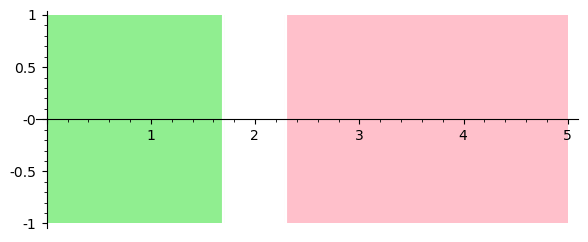

In [10]:
sig = P.signal_for_system(vf, v3, 5, order=5, step=0.01,
                    precondition=1,
                    estimation=1e-3,
                    integrationScheme=2,
                    cutoff_threshold=1e-5,
                    symbolic_composition=True)
sig.plot()

In [11]:
csig = P.context_signal_for_system(vf, v3, 5, order=5, step=0.01,
                    precondition=1,
                    estimation=1e-3,
                    integrationScheme=2,
                    cutoff_threshold=1e-5,
                    symbolic_composition=True)

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[1.0000000000000000 .. 1.1000000000000001], [4 .. 5]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7fe33c3440a0>, ctx_ma

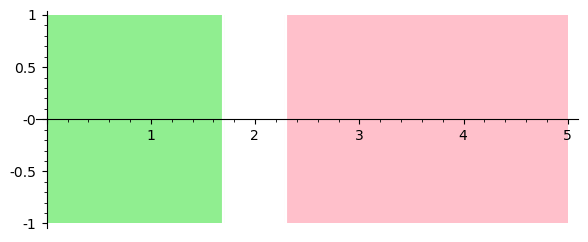

In [12]:
csig.refined_signal(0).plot()

 ==> creating ContextSignal with coord=(0,), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.

top-level root detection: 1 items in 0.34 seconds
roots = [[1.7358892183644025 .. 2.1458599998453090]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7358892183644025 .. 2.1458599998453090]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7358892183644025 .. 2.1458599998453090]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2,), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.7358892183644026], True), ([2.1458599998453089 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3,), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<

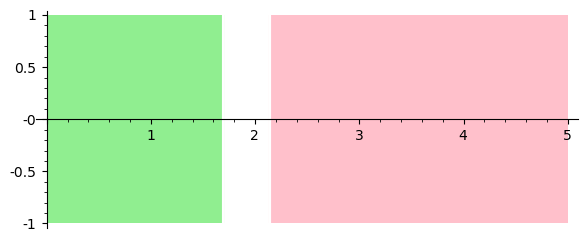

In [13]:
csig.refined_signal(1).plot()

 ==> creating ContextSignal with coord=(0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -

top-level root detection: 1 items in 0.23 seconds
roots = [[2.0428401870018602 .. 2.1727166479469027]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0428401870018602 .. 2.1727166479469027]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0428401870018602 .. 2.1727166479469027]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0428401870018603], True), ([2.1727166479469026 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrument

=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7fe33c350190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.23 seconds
roots = [[2.0171388362457105 .. 2.1501488543440460]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0171388362457105 .. 2.1501488543440460]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0171388362457105 .. 2.1501488543440460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0171388362457106], True), ([2.1501488543440459 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.01000000000000

top-level root detection: 1 items in 0.22 seconds
roots = [[1.9249717918990085 .. 2.0800000000000037]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9249717918990085 .. 2.0800000000000037]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9249717918990085 .. 2.0800000000000037]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9249717918990086], True), ([2.0800000000000036 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrument

top-level root detection: 1 items in 0.21 seconds
roots = [[1.7699999999999527 .. 1.7800000000000016], [1.9068876630030100 .. 2.0669242937782309]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7699999999999527 .. 1.7800000000000016], 
 [1.9068876630030100 .. 2.0669242937782309]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7699999999999527 .. 1.7800000000000016], 
 [1.9068876630030100 .. 2.0669242937782309]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.7699999999999528], True), ([1.7800000000000015 .. 1.9068876630030101], True), ([2.0669242937782308 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems

top-level root detection: 1 items in 0.22 seconds
roots = [[1.7373024212509586 .. 2.0062699865553709]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7373024212509586 .. 2.0062699865553709]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7373024212509586 .. 2.0062699865553709]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.7373024212509587], True), ([2.0062699865553708 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None


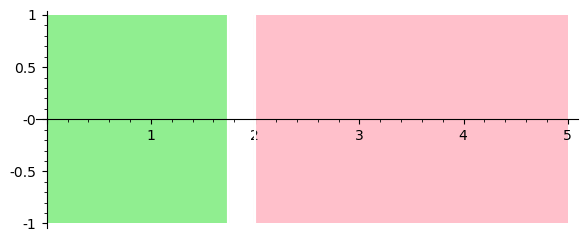

In [14]:
csig.refined_signal(2).plot()

In [15]:

res = csig.refined_signal(3).plot()

 ==> creating ContextSignal with coord=(0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 

top-level root detection: 1 items in 0.19 seconds
roots = [[2.1683949054064894 .. 2.2400115090276458]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1683949054064894 .. 2.2400115090276458]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1683949054064894 .. 2.2400115090276458]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1683949054064895], True), ([2.2400115090276457 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[2.1484357379064413 .. 2.2186151129399395]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1484357379064413 .. 2.2186151129399395]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1484357379064413 .. 2.2186151129399395]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1484357379064414], True), ([2.2186151129399394 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.19 seconds
roots = [[2.0622603155595573 .. 2.1283235093875424]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0622603155595573 .. 2.1283235093875424]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0622603155595573 .. 2.1283235093875424]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0622603155595574], True), ([2.1283235093875423 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[2.0447057241029562 .. 2.1080111449956465]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0447057241029562 .. 2.1080111449956465]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0447057241029562 .. 2.1080111449956465]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0447057241029563], True), ([2.1080111449956464 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[2.1231705665614910 .. 2.1963450454867588]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1231705665614910 .. 2.1963450454867588]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1231705665614910 .. 2.1963450454867588]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1231705665614911], True), ([2.1963450454867587 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.19 seconds
roots = [[2.0949080771377550 .. 2.1747137530191326]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0949080771377550 .. 2.1747137530191326]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0949080771377550 .. 2.1747137530191326]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0949080771377551], True), ([2.1747137530191325 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.20 seconds
roots = [[2.0214148919276140 .. 2.0882285368856657]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0214148919276140 .. 2.0882285368856657]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0214148919276140 .. 2.0882285368856657]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0214148919276141], True), ([2.0882285368856656 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9957366672250433 .. 2.0691671587910517]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9957366672250433 .. 2.0691671587910517]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9957366672250433 .. 2.0691671587910517]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9957366672250434], True), ([2.0691671587910516 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.19 seconds
roots = [[1.9476975229789306 .. 2.0385389034434156]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9476975229789306 .. 2.0385389034434156]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9476975229789306 .. 2.0385389034434156]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9476975229789307], True), ([2.0385389034434155 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[1.9338508096150501 .. 2.0200000000000023]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9338508096150501 .. 2.0200000000000023]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9338508096150501 .. 2.0200000000000023]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9338508096150502], True), ([2.0200000000000022 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[1.8328984934344443 .. 1.9757590526752995]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8328984934344443 .. 1.9757590526752995]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8328984934344443 .. 1.9757590526752995]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8328984934344444], True), ([1.9757590526752994 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.19 seconds
roots = [[1.8245303019786414 .. 1.9600000000000018]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8245303019786414 .. 1.9600000000000018]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8245303019786414 .. 1.9600000000000018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8245303019786415], True), ([1.9600000000000017 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9251827270979013 .. 2.0114204844423794]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9251827270979013 .. 2.0114204844423794]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9251827270979013 .. 2.0114204844423794]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9251827270979014], True), ([2.0114204844423793 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9025902153594680 .. 1.9969590276986134]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9025902153594680 .. 1.9969590276986134]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9025902153594680 .. 1.9969590276986134]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9025902153594681], True), ([1.9969590276986133 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, inst

top-level root detection: 1 items in 0.18 seconds
roots = [[1.7399999999999540 .. 1.7500000000000016], [1.8116810969498267 .. 1.9455664447852897]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7399999999999540 .. 1.7500000000000016], 
 [1.8116810969498267 .. 1.9455664447852897]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7399999999999540 .. 1.7500000000000016], 
 [1.8116810969498267 .. 1.9455664447852897]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(3, 2, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.7399999999999541], True), ([1.7500000000000015 .. 1.8116810969498268], True), ([1.9455664447852896 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_s

top-level root detection: 1 items in 0.19 seconds
roots = [[1.7888165428477826 .. 1.7900000000000016], [1.7900097157784047 .. 1.9340558365811005]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7888165428477826 .. 1.7900000000000016], 
 [1.7900097157784047 .. 1.9340558365811005]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.7888165428477826 .. 1.7900000000000016], 
 [1.7900097157784047 .. 1.9340558365811005]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(3, 3, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.7888165428477827], True), ([1.7900000000000015 .. 1.7900097157784048], True), ([1.9340558365811004 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_s

 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.10000000

top-level root detection: 1 items in 0.21 seconds
roots = [[2.2370312965370877 .. 2.2747269458756563]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2370312965370877 .. 2.2747269458756563]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2370312965370877 .. 2.2747269458756563]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2370312965370878], True), ([2.2747269458756562 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.22 seconds
roots = [[2.2322241258123409 .. 2.2697587006001179]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2322241258123409 .. 2.2697587006001179]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2322241258123409 .. 2.2697587006001179]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2322241258123410], True), ([2.2697587006001178 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

roots = [[2.2079938246588688 .. 2.2450539732921433]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2079938246588688 .. 2.2450539732921433]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2079938246588689], True), ([2.2450539732921432 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7fe33c3aa7c0>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialFo

top-level root detection: 1 items in 0.17 seconds
roots = [[2.2034078967410608 .. 2.2400000000000074]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2034078967410608 .. 2.2400000000000074]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2034078967410608 .. 2.2400000000000074]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2034078967410609], True), ([2.2400000000000073 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.20 seconds
roots = [[2.1699691750077185 .. 2.1700000000000058], [2.1702395304435335 .. 2.2056228715479094]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1699691750077185 .. 2.1700000000000058], 
 [2.1702395304435335 .. 2.2056228715479094]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1699691750077185 .. 2.1700000000000058], 
 [2.1702395304435335 .. 2.2056228715479094]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1699691750077186], True), ([2.1700000000000057 .. 2.1702395304435336], True), ([2.2056228715479093 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precom

top-level root detection: 1 items in 0.21 seconds
roots = [[2.2218965273210540 .. 2.2586524354395854]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2218965273210540 .. 2.2586524354395854]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2218965273210540 .. 2.2586524354395854]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2218965273210541], True), ([2.2586524354395853 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.18 seconds
roots = [[2.2110063639764376 .. 2.2470838926444401]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2110063639764376 .. 2.2470838926444401]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2110063639764376 .. 2.2470838926444401]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2110063639764377], True), ([2.2470838926444400 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.25 seconds
roots = [[2.1878539813439847 .. 2.2233621357436096]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1878539813439847 .. 2.2233621357436096]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1878539813439847 .. 2.2233621357436096]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1878539813439848], True), ([2.2233621357436095 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1826727229659579 .. 2.2180121112559142]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1826727229659579 .. 2.2180121112559142]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1826727229659579 .. 2.2180121112559142]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1826727229659580], True), ([2.2180121112559141 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1563065532951539 .. 2.1919512161191670]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1563065532951539 .. 2.1919512161191670]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1563065532951539 .. 2.1919512161191670]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1563065532951540], True), ([2.1919512161191669 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.1472731777554225 .. 2.1821555374420095]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1472731777554225 .. 2.1821555374420095]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1472731777554225 .. 2.1821555374420095]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1472731777554226], True), ([2.1821555374420094 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.1020872182277052 .. 2.1364660388052977]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1020872182277052 .. 2.1364660388052977]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1020872182277052 .. 2.1364660388052977]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1020872182277053], True), ([2.1364660388052976 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.18 seconds
roots = [[2.0937699992164819 .. 2.1272980701484601]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0937699992164819 .. 2.1272980701484601]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0937699992164819 .. 2.1272980701484601]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0937699992164820], True), ([2.1272980701484600 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1376917790017202 .. 2.1718595441598470]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1376917790017202 .. 2.1718595441598470]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1376917790017202 .. 2.1718595441598470]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1376917790017203], True), ([2.1718595441598469 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1276004835681225 .. 2.1611047102885755]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1276004835681225 .. 2.1611047102885755]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1276004835681225 .. 2.1611047102885755]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1276004835681226], True), ([2.1611047102885754 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.0848427847934996 .. 2.1176262820197840]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0848427847934996 .. 2.1176262820197840]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0848427847934996 .. 2.1176262820197840]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0848427847934997], True), ([2.1176262820197839 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.0753252631166616 .. 2.1074940818551089]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0753252631166616 .. 2.1074940818551089]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0753252631166616 .. 2.1074940818551089]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0753252631166617], True), ([2.1074940818551088 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.2278137637916461 .. 2.2646469993253314]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2278137637916461 .. 2.2646469993253314]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2278137637916461 .. 2.2646469993253314]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2278137637916462], True), ([2.2646469993253313 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.2150102364740731 .. 2.2529789308789386]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2150102364740731 .. 2.2529789308789386]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2150102364740731 .. 2.2529789308789386]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2150102364740732], True), ([2.2529789308789385 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.1711055401499348 .. 2.2063266753615998]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1711055401499348 .. 2.2063266753615998]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1711055401499348 .. 2.2063266753615998]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1711055401499349], True), ([2.2063266753615997 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.1583236010574364 .. 2.1951096127871015]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1583236010574364 .. 2.1951096127871015]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1583236010574364 .. 2.1951096127871015]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1583236010574365], True), ([2.1951096127871014 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.20 seconds
roots = [[2.2014340449682081 .. 2.2409731958909683]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2014340449682081 .. 2.2409731958909683]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.2014340449682081 .. 2.2409731958909683]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.2014340449682082], True), ([2.2409731958909682 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1872963670567684 .. 2.2294950592997154]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1872963670567684 .. 2.2294950592997154]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1872963670567684 .. 2.2294950592997154]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1872963670567685], True), ([2.2294950592997153 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.1455401428737479 .. 2.1835767273271483]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1455401428737479 .. 2.1835767273271483]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1455401428737479 .. 2.1835767273271483]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1455401428737480], True), ([2.1835767273271482 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.1320764011133928 .. 2.1717510328062133]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1320764011133928 .. 2.1717510328062133]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1320764011133928 .. 2.1717510328062133]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1320764011133929], True), ([2.1717510328062132 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.1166801381520361 .. 2.1500000000000053]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1166801381520361 .. 2.1500000000000053]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1166801381520361 .. 2.1500000000000053]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1166801381520362], True), ([2.1500000000000052 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.14 seconds
roots = [[2.1048241320149205 .. 2.1400000000000051]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1048241320149205 .. 2.1400000000000051]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.1048241320149205 .. 2.1400000000000051]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.1048241320149206], True), ([2.1400000000000050 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.0649671960829913 .. 2.0969937584964944]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0649671960829913 .. 2.0969937584964944]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0649671960829913 .. 2.0969937584964944]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0649671960829914], True), ([2.0969937584964943 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.18 seconds
roots = [[2.0535953888563871 .. 2.0869519681072611]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0535953888563871 .. 2.0869519681072611]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0535953888563871 .. 2.0869519681072611]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0535953888563872], True), ([2.0869519681072610 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.0923383758670297 .. 2.1290521509122567]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0923383758670297 .. 2.1290521509122567]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0923383758670297 .. 2.1290521509122567]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0923383758670298], True), ([2.1290521509122566 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.0791507351035933 .. 2.1178054577622172]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0791507351035933 .. 2.1178054577622172]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0791507351035933 .. 2.1178054577622172]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0791507351035934], True), ([2.1178054577622171 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.0417593579624799 .. 2.0766017759856462]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0417593579624799 .. 2.0766017759856462]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0417593579624799 .. 2.0766017759856462]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0417593579624800], True), ([2.0766017759856461 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[2.0292455067264816 .. 2.0659913023911627]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0292455067264816 .. 2.0659913023911627]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0292455067264816 .. 2.0659913023911627]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0292455067264817], True), ([2.0659913023911626 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.0484515404386804 .. 2.0837483427387938]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0484515404386804 .. 2.0837483427387938]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0484515404386804 .. 2.0837483427387938]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0484515404386805], True), ([2.0837483427387937 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.19 seconds
roots = [[2.0410380719148899 .. 2.0752315638636528]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0410380719148899 .. 2.0752315638636528]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0410380719148899 .. 2.0752315638636528]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0410380719148900], True), ([2.0752315638636527 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.19 seconds
roots = [[1.9935699406828841 .. 2.0376683921689112]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9935699406828841 .. 2.0376683921689112]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9935699406828841 .. 2.0376683921689112]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9935699406828842], True), ([2.0376683921689111 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9865910685055896 .. 2.0298184171908025]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9865910685055896 .. 2.0298184171908025]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9865910685055896 .. 2.0298184171908025]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9865910685055897], True), ([2.0298184171908024 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.0327988548292492 .. 2.0662230025318014]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0327988548292492 .. 2.0662230025318014]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0327988548292492 .. 2.0662230025318014]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0327988548292493], True), ([2.0662230025318013 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.0239863803987114 .. 2.0567512841596721]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0239863803987114 .. 2.0567512841596721]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0239863803987114 .. 2.0567512841596721]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0239863803987115], True), ([2.0567512841596720 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9788946958022104 .. 2.0205766919127007]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9788946958022104 .. 2.0205766919127007]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9788946958022104 .. 2.0205766919127007]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9788946958022105], True), ([2.0205766919127006 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9711511501195391 .. 2.0117799872045028]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9711511501195391 .. 2.0117799872045028]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9711511501195391 .. 2.0117799872045028]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9711511501195392], True), ([2.0117799872045027 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9389421151372521 .. 1.9939620419719125]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9389421151372521 .. 1.9939620419719125]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9389421151372521 .. 1.9939620419719125]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9389421151372522], True), ([1.9939620419719124 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9334704829511961 .. 1.9867955805546376]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9334704829511961 .. 1.9867955805546376]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9334704829511961 .. 1.9867955805546376]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9334704829511962], True), ([1.9867955805546375 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.8858346128946379 .. 1.9536063333179843]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8858346128946379 .. 1.9536063333179843]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8858346128946379 .. 1.9536063333179843]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8858346128946380], True), ([1.9536063333179842 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[1.8808642535392809 .. 1.9471283453364950]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8808642535392809 .. 1.9471283453364950]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8808642535392809 .. 1.9471283453364950]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8808642535392810], True), ([1.9471283453364949 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.9266606846076566 .. 1.9791446717852180]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9266606846076566 .. 1.9791446717852180]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9266606846076566 .. 1.9791446717852180]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9266606846076567], True), ([1.9791446717852179 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9191395285898020 .. 1.9700000000000018]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9191395285898020 .. 1.9700000000000018]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9191395285898020 .. 1.9700000000000018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9191395285898021], True), ([1.9700000000000017 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.24 seconds
roots = [[1.8752006204601521 .. 1.9400000000000018]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8752006204601521 .. 1.9400000000000018]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8752006204601521 .. 1.9400000000000018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8752006204601522], True), ([1.9400000000000017 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.8683602246802348 .. 1.9314445688087745]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8683602246802348 .. 1.9314445688087745]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8683602246802348 .. 1.9314445688087745]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8683602246802349], True), ([1.9314445688087744 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[2.0145899055523397 .. 2.0472640252432535]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0145899055523397 .. 2.0472640252432535]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0145899055523397 .. 2.0472640252432535]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0145899055523398], True), ([2.0472640252432534 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[2.0038805389115257 .. 2.0379476002635549]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0038805389115257 .. 2.0379476002635549]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[2.0038805389115257 .. 2.0379476002635549]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 2.0038805389115258], True), ([2.0379476002635548 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9624771765002373 .. 2.0030213197578882]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9624771765002373 .. 2.0030213197578882]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9624771765002373 .. 2.0030213197578882]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9624771765002374], True), ([2.0030213197578881 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9523395960400180 .. 1.9945789924868434]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9523395960400180 .. 1.9945789924868434]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9523395960400180 .. 1.9945789924868434]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9523395960400181], True), ([1.9945789924868433 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.9927117850718409 .. 2.0283354476535971]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9927117850718409 .. 2.0283354476535971]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9927117850718409 .. 2.0283354476535971]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9927117850718410], True), ([2.0283354476535970 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.9799999999999435 .. 2.0184793815118965]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9799999999999435 .. 2.0184793815118965]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9799999999999435 .. 2.0184793815118965]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9799999999999436], True), ([2.0184793815118964 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[1.9417242438238699 .. 1.9858697769788794]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9417242438238699 .. 1.9858697769788794]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9417242438238699 .. 1.9858697769788794]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9417242438238700], True), ([1.9858697769788793 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.9306648444974721 .. 1.9769521423962498]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9306648444974721 .. 1.9769521423962498]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9306648444974721 .. 1.9769521423962498]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9306648444974722], True), ([1.9769521423962497 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.9116001741944537 .. 1.9619779494125247]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9116001741944537 .. 1.9619779494125247]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9116001741944537 .. 1.9619779494125247]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9116001741944538], True), ([1.9619779494125246 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.9020422398435350 .. 1.9545056518784981]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9020422398435350 .. 1.9545056518784981]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.9020422398435350 .. 1.9545056518784981]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.9020422398435351], True), ([1.9545056518784980 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.16 seconds
roots = [[1.8616057402927481 .. 1.9242861476714395]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8616057402927481 .. 1.9242861476714395]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8616057402927481 .. 1.9242861476714395]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8616057402927482], True), ([1.9242861476714394 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
fprime = (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f

top-level root detection: 1 items in 0.20 seconds
roots = [[1.8275886210802505 .. 1.9000000000000017]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8275886210802505 .. 1.9000000000000017]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8275886210802505 .. 1.9000000000000017]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 2), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8275886210802506], True), ([1.9000000000000016 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.19 seconds
roots = [[1.8866298324145125 .. 1.9422840091971412]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8866298324145125 .. 1.9422840091971412]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8866298324145125 .. 1.9422840091971412]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8866298324145126], True), ([1.9422840091971411 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.17 seconds
roots = [[1.8759909668535290 .. 1.9343067535048473]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8759909668535290 .. 1.9343067535048473]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8759909668535290 .. 1.9343067535048473]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 1, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8759909668535291], True), ([1.9343067535048472 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.15 seconds
roots = [[1.8376710205513344 .. 1.9072724002422972]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8376710205513344 .. 1.9072724002422972]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8376710205513344 .. 1.9072724002422972]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 1), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8376710205513345], True), ([1.9072724002422971 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.20 seconds
roots = [[1.8329968645899639 .. 1.9031356270498181]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8329968645899639 .. 1.9031356270498181]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8329968645899639 .. 1.9031356270498181]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 0), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8329968645899640], True), ([1.9031356270498180 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True

top-level root detection: 1 items in 0.19 seconds
roots = [[1.8037258733008543 .. 1.8834184592530703]]
domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8037258733008543 .. 1.8834184592530703]]
seg_domain = [0.0000000000000000 .. 5.0019999999999998]
roots = [[1.8037258733008543 .. 1.8834184592530703]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 5.0000000000000000], [([0.0000000000000000 .. 1.8037258733008544], True), ([1.8834184592530702 .. 5.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None


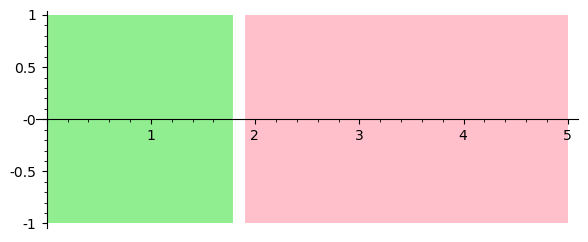

In [16]:
csig.refined_signal(4).plot()

In [17]:
dir(csig)

['F',
 'G',
 'R',
 'U',
 '__and__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__invert__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__or__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_children',
 '_context_embedding',
 '_coordinate',
 '_dimension',
 '_domain',
 '_reach_level',
 '_reach_tree',
 '_restriction_method',
 '_signal',
 '_top_level_domain',
 'children',
 'consistent_with',
 'coordinate',
 'dimension',
 'domain',
 'enclosed_by',
 'expand_signals',
 'histogram2d',
 'physical_coordinate',
 'physical_space_domain',
 'plot_histogram2d',
 'reach_level',
 'refined_signal',
 'restriction_method',
 'signal',
 'signal_map',
 'signal_zip_with',
 'symbolic_coordinate',
 'symbolic_space_domain',
 'to_domain',
 'to_mask_and',
 'to_mask_or',
 'to_mask_until',
 'top_level_domain']

In [18]:
help(csig.plot_histogram2d)

Help on method plot_histogram2d in module lbuc.context_signals:

plot_histogram2d(n: int, flip: bool = False) method of lbuc.context_signals.ContextSignal instance



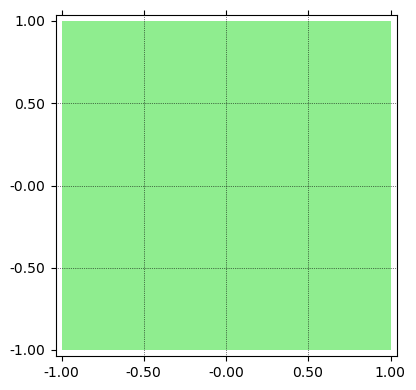

In [19]:
csig.plot_histogram2d(2)

 ==> creating ContextSignal with coord=(), signal = Signal([0.0000000000000000 .. 3.0000000000000000], [([0.32000000000000916 .. 3.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0,), signal = Signal([0.0000000000000000 .. 3.0000000000000000], [([0.0000000000000000 .. 0.029636442193807345], True), ([0.030000000000002469 .. 0.032957326251907393], True), ([0.31379278209286365 .. 3.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 3.0000000000000000], [([0.26999096091156982 .. 3.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2,), signal = Signal([0.0000000000000000 .. 3.0000000000000000], [([0.14585999984530895 .. 3.0000000000000000], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3,), signal = Signal([0.0000

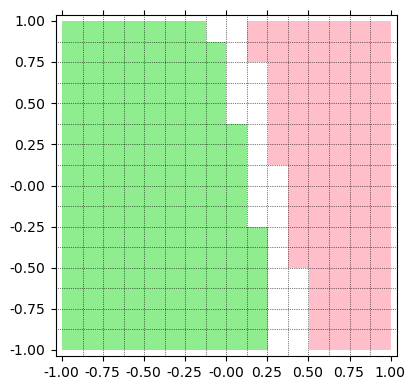

In [20]:
csig.G(2).plot_histogram2d(4)

In [21]:
csig.refined_signal(4)(2)

False

## Around stable fixed point

In [27]:
Qbox = [RIF(0, 0.3), RIF(1.75, 3.5)]

In [28]:
Q = (  Atomic(var("x") < Qbox[0].upper())
     & Atomic(var("x") > Qbox[0].lower())
     & Atomic(var("y") < Qbox[1].upper())
     & Atomic(var("y") > Qbox[1].lower()) )

In [39]:
prop = G(RIF(0,5), ~Q | F(RIF(0, 5), Q))

In [43]:
csig = prop.context_signal_for_system(vf,
    B, 0, order=8, step=(0.01, 0.5),
    precondition=1,
    integration_method=2,
    cutoff_threshold=1e-10,
    estimation=1e-5,
    symbolic_composition=True)

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.0000000000000000 .. 0.29999999999999999], [1.7500000000000000 .. 3.5000000000000000]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7fe32d0a9ca0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7fe32d0a9e50>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=8, step=(0.0100000000000000, 0.500000000000000), precondition=1, integration_method=2, cutoff_thres

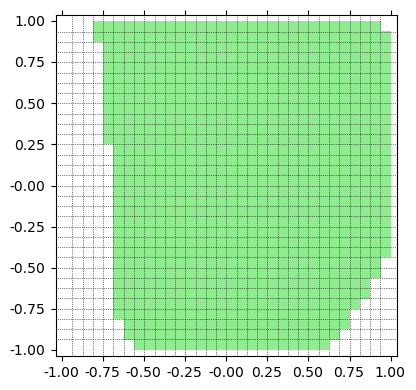

In [44]:
with suppress_stdout():
    p = csig.plot_histogram2d(5)
    
p

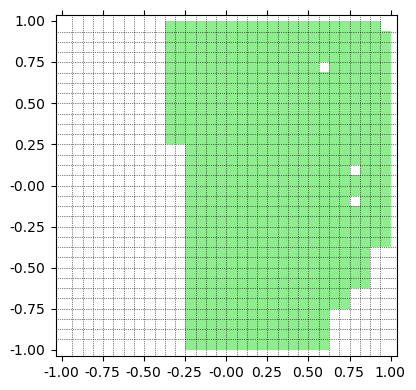

In [38]:
with suppress_stdout():
    p = csig.plot_histogram2d(5)
    
p

# Around the attractor

In [ ]:
B = [RIF(0, 1.5), RIF(0, 8)]

In [ ]:
P

In [ ]:
prop = F(RIF(0, 10), P)

In [ ]:
csig = prop.context_signal_for_system(vf,
    B, 5, order=5, step=0.01,
    precondition=1,
    estimation=1e-3,
    integration_method=2,
    cutoff_threshold=1e-5,
    symbolic_composition=True)

In [ ]:
csig.signal.plot()

In [ ]:
csig.refined_signal(3).plot()

In [ ]:
csig.plot_histogram2d(3)

In [ ]:
csig.plot_histogram2d(4)

In [ ]:
prop = F(RIF(0, 5), P)

In [ ]:
csig = prop.context_signal_for_system(vf,
    B, 0, order=5, step=0.01,
    precondition=1,
    estimation=1e-3,
    integration_method=2,
    cutoff_threshold=1e-5,
    symbolic_composition=True)

In [ ]:
csig.plot_histogram2d(3)

In [32]:
#csig.plot_histogram2d(5)

# Multiple sets

In [33]:
def plot_box(B, **kwargs):
    if 'color' not in kwargs:
        kwargs['color'] = 'orange'
    return polygon(
        [(B[0].lower(), B[1].lower()),
         (B[0].lower(), B[1].upper()),
         (B[0].upper(), B[1].upper()),
         (B[0].upper(), B[1].lower())],
        **kwargs,
    )

In [34]:
v4 = [RIF(0.2, 0.4), RIF(7, 8)]
v5 = [RIF(0.4, 1.0), RIF(6, 7)]
v6 = [RIF(0.2, 0.6), RIF(2, 3)]

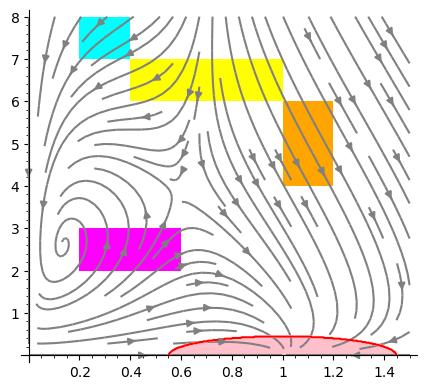

In [35]:
p = streamline_plot(tuple(vf),(x,0,1.5),(y,0,8), color='grey')\
    + plot_box(v2)\
    + plot_box(v4, color='cyan')\
    + plot_box(v5, color='yellow')\
    + plot_box(v6, color='magenta')\
    + region_plot((lambda x, y: (x - 1)^2 + y^2 - 0.2 < 0),
                  (x, 0, 1.5),
                  (y, 0, 8),
                  incol='pink', plot_points=500, bordercol='red')
p.set_aspect_ratio(1/6)
p.show()

In [36]:
def plot_reach(B, duration=10, poly=None, **kwargs):
    global p
    kwargs_ = dict(
        order=5, step=(0.01, 0.5),
        precondition=1,
        estimation=1e-3,
        integrationScheme=2,
        cutoff_threshold=1e-7,
        symbolic_composition=True,
    )
    kwargs_.update(kwargs)
    reach = Reach(vf, B, duration, **kwargs_)
    return p + reach.sage_interval_plot(
        'x', 'y',
        poly=poly,
        aspect_ratio='automatic')

var_id_x = 0
var_id_y = 1
PolyObserver(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000, <flowstar.reachability.Reach object at 0x7f11e2e5ddc0>, None, symbolic_composition=True, symbolic_composition_order=-1, tentative_unpreconditioning=False, mask=None)


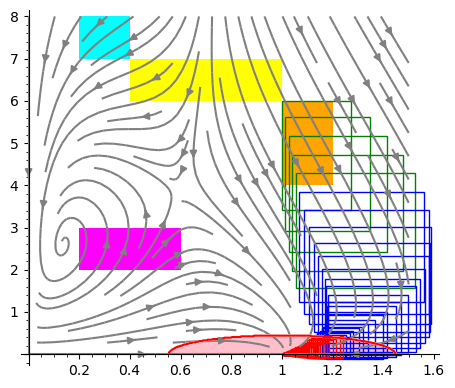

In [37]:
p2 = plot_reach(v2, poly=(x - 1)^2 + y^2 - 0.2)
p2.save("phase_portrait.pdf")
p2

In [38]:
Qbox = [RIF(0, 0.3), RIF(1.75, 3.5)]

var_id_x = 0
var_id_y = 1


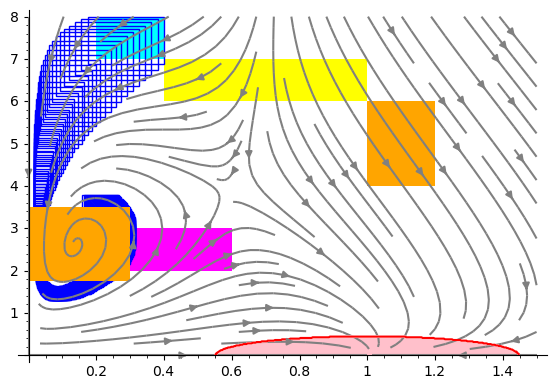

In [39]:
Qplt = plot_reach(v4, duration=25, step=(0.01, 0.5), order=6, estimation=1e-5, cutoff_threshold=1e-10) + plot_box(Qbox)
Qplt.show(aspect_ratio=1/8)

In [40]:
[x.str(style='brackets') for x in v4]

['[0.20000000000000001 .. 0.40000000000000003]',
 '[7.0000000000000000 .. 8.0000000000000000]']

In [41]:
def plot_reach_(B, duration=10, poly=None, **kwargs):
    global p
    kwargs_ = dict(
        order=5, step=(0.01, 0.5),
        precondition=1,
        estimation=1e-3,
        integrationScheme=2,
        cutoff_threshold=1e-7,
        symbolic_composition=True,
    )
    kwargs_.update(kwargs)
    reach = Reach(vf, B, duration, **kwargs_)
    return p + reach.sage_interval_plot(
        'x', 'y',
        poly=poly,
        aspect_ratio='automatic')

var_id_x = 0
var_id_y = 1


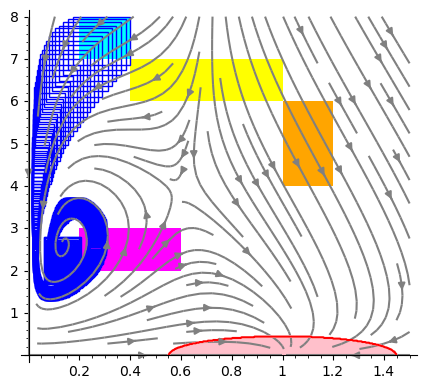

In [42]:
plot_reach(v4, duration=40, step=(0.01, 0.5), order=8, estimation=1e-5, cutoff_threshold=1e-10)

S=[0.1?, 3.?]
S1=(1.1?, 3.?)
var_id_x = 0
var_id_y = 1
var_id_x = 0
var_id_y = 1


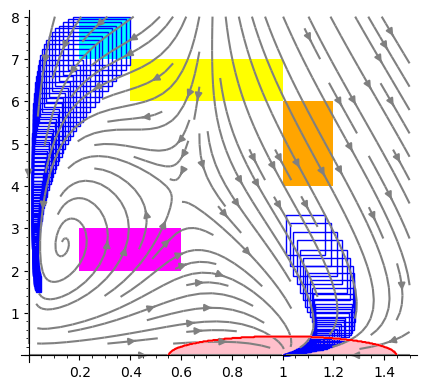

In [43]:
kwargs_ = dict(
    order=5, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-3,
    integrationScheme=2,
    cutoff_threshold=1e-7,
    symbolic_composition=True,
)
reach = Reach(vf, v4, 10, **kwargs_)
S = reach(RIF(5,5.1))
print(f"{S=}")
S1 = vector(S) + vector([RIF(1,1.1), 0])
print(f"{S1=}")
reach1 = Reach(vf, S1, 10, **kwargs_)
p2 = p
p2 += reach.sage_interval_plot(
        'x', 'y',
        aspect_ratio='automatic')
p2 += reach1.sage_interval_plot(
        'x', 'y',
        aspect_ratio='automatic')
p2

S=[0.1?, 4.?]
S1=(1.1?, 4.?)
var_id_x = 0
var_id_y = 1
var_id_x = 0
var_id_y = 1


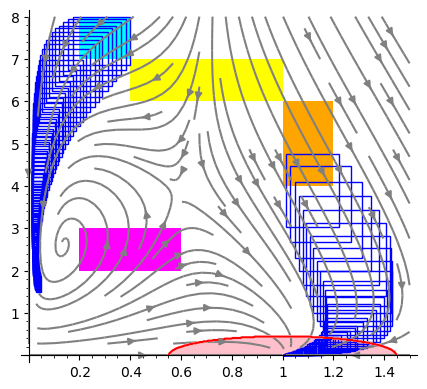

In [44]:
kwargs_ = dict(
    order=5, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-3,
    integrationScheme=2,
    cutoff_threshold=1e-7,
    symbolic_composition=True,
)
reach = Reach(vf, v4, 10, **kwargs_)
S = reach(RIF(3,3.5))
print(f"{S=}")
S1 = vector(S) + vector([RIF(1,1.1), 0])
print(f"{S1=}")
reach1 = Reach(vf, S1, 10, **kwargs_)
p2 = p
p2 += reach.sage_interval_plot(
        'x', 'y',
        aspect_ratio='automatic')
p2 += reach1.sage_interval_plot(
        'x', 'y',
        aspect_ratio='automatic')
p2

In [45]:
prop2 = F(RIF(0, 10), Q) & {x: RIF(0.9,1.1)} >> F(RIF(0, 5), G(RIF(0, 5), ~P))

NameError: name 'Q' is not defined

In [ ]:
prop2.signal_for_system(vf, v4, 5, **kwargs_)

In [ ]:
csig = prop2.context_signal_for_system(vf, v4, 5, **kwargs_)

In [ ]:
p2

In [ ]:
plot_reach(v5)

In [ ]:
plot_reach(v6)

In [ ]:
prop3 = F(RIF(0, 10), Q) | F(RIF(0, 5), G(RIF(0, 5), ~P))

In [ ]:
csig3 = prop3.context_signal_for_system(vf, v5, 5, **kwargs_)

In [ ]:
with suppress_stdout():
    p = csig3.plot_histogram2d(5)
    
p

In [98]:
prop4 = ~ ({x: RIF(-0.6, 0.6)} >> ~ (F(RIF(0, 10), Q) | F(RIF(0, 5), G(RIF(0, 5), ~P))))

In [104]:
csig4 = prop4.context_signal_for_system(vf, v5, 5, **kwargs_, use_masks=True, refine=4)

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.40000000000000002 .. 1.0000000000000000], [6 .. 7]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function C.context_signal.<locals>.signal_fn at 0x7f801c582c10>, reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f801d235700>, ctx_mask=<lbuc.context_masks.ContextMask object at 0x7f801c966e50>
contexts = ['[0.4..1.0]', '[6.0..7.0]']
statics  = []
recomputing reachset
setting reach level to 0
mask = None
phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.32765424938768283 .. 1.0697248282006211], [5.2511023889924324 .. 7.3327187967704460]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d44aee0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d44a280>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d44a700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d44a700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801d3bd970>
 ==> creating ContextSignal with coord=(0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal wit

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d44aca0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d44aee0>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d44aee0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d3ad280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d3ad280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d3ad4c0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801d3ad700>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d3ad700>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d3ad820>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d3addc0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2a6280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a6280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2a6040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a6040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2a6700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a6700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801d2a6820>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a6820>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801d2a6820>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a6820>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d2a6dc0>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2a6dc0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2a64c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2a64c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

 ==> creating ContextSignal with coord=(1, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801e73ab40>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f801d2ee7f0>, ctx_mask=None
recomputing reachset
PolyObserver(y - 1.7500000000000000?, <flowstar.reachability.Reach object at 0x7f801d272040>, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.05

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2725e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2725e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d272280>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d272280>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d272820>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn

var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801e160ac0>
 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composit

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801fc672e0>
 ==> creating ContextSignal with coord=(0, 0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 0), signal

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d987280>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d987280>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d272820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d272820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801d987a60>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d987a60>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d987a60>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.29999999

fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801ff8c970>
 ==> creating ContextSignal with coord=(1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801e73ab40>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.ReachTree ob

var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d388b80>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.32765424938768283 .. 1.0697248282006211], [5.2511023889924324 .. 7.3327187967704460]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f801c760a60>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f801c760550>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, in

res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
PolyObserver((([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2)), <flowstar.reachability.Reach object at 0x7f801d3884c0>, (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.39999999

res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d388280>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , 

fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f80216fe580>
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d388700>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d388ca0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] *

PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d388ee0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801d498970>
 ==> creating ContextSignal with coord=(1, 0, 0), signal = Signal([0.0000000000000000 .. 10.00600000000

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d388ee0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d388040>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801ce53ca0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.32765424938768283 .. 1.0697248282006211], [5.2511023889924324 .. 7.3327187967704460]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f801c7bf940>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f801c7bf700>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, in

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801ce535e0>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ce535e0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801ce533a0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ce53a60>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 ,

PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ce53700>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801d38c2e0>
 ==> creating ContextSignal with coord=(0, 1, 0), signal = Signal([0.0000000000000000 .. 10.00600000000

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801ce53700>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ce53700>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2f3700>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2f34c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2f34c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d2f3ca0>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2f3ca0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d2f3dc0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d2f3940>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2f3940>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d2f3940>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2f3940>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

In [102]:
csig4.signal

Signal([0.0000000000000000 .. 5.0000000000000000], [], mask=None)

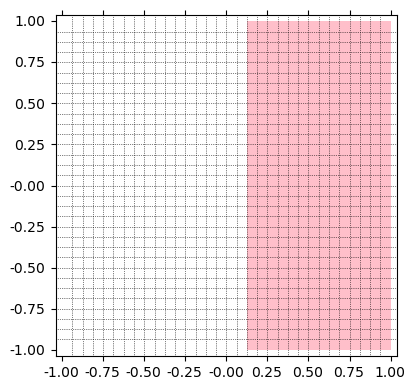

In [95]:
with suppress_stdout():
    p = csig4.plot_histogram2d(2)
    
p

In [106]:
csig5 = prop4.context_signal_for_system(vf, v5, 5, **kwargs_, use_masks=True, refine=4)

phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.40000000000000002 .. 1.0000000000000000], [6 .. 7]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function C.context_signal.<locals>.signal_fn at 0x7f801c727940>, reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f801cde98e0>, ctx_mask=<lbuc.context_masks.ContextMask object at 0x7f8021ad4490>
contexts = ['[0.4..1.0]', '[6.0..7.0]']
statics  = []
recomputing reachset
setting reach level to 0
mask = None
phi variables sfs = {y, x}
system sfs = System(R, (x, y), [[0.32765424938768283 .. 1.0697248282006211], [5.2511023889924324 .. 7.3327187967704460]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999

res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d2f35e0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] *

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801cd47c10>
 ==> creating ContextSignal with coord=(0, 0, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentatio

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ce045e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ce045e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801ce045e0>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ce045e0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d2f3820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d2f3820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ce044c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ce044c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ce04ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ce04ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801ef25eb0>
 ==> creating ContextSignal with coord=(1, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal wit

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801cd0feb0>
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentatio

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801d20eee0>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d20eee0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d20e820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d20e820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d20ea60>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(y - 1.7500000000000000?, <flowstar.reachability.Reach object at 0x7f801d20e3a0>, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d20e3a0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.600000000

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d20e700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d20e700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801d20eb80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801d20eb80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 0.0040000000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1,), signal = Signal([0.0000000000000000 .. 0.0020000000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0), signal = <function base

fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801d4bed60>
 ==> creating ContextSignal with coord=(1, 0, 0, 0), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801f67a640>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.

 ==> creating ContextSignal with coord=(1, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801f67a640>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f801d19a340>, ctx_mask=None
recomputing reachset
PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801ca9eee0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2

setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
PolyObserver((([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2)), <flowstar.reachability.Reach object at 0x7f801ca9e820>, (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] *

 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 0.0040000000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ca9e160>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
obse

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ca9e5e0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
obse

setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ca9e5e0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500

var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
fprime = (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f

var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
PolyObserver((([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2)), <flowstar.reachability.Reach object at 0x7f801ca9ea60>, (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 

var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ca9e160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.599999

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801eec9ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec9ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f8020644190>
 ==> creating ContextSignal with coord=(1, 0, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=T

fprime = (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801c692190>
 ==> creating ContextSignal with coord=(1, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 1), signal = Signal([0.0000000000000000 .. 10.006000000000001], [], mask=None), reach_tree 

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801eec9a60>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec9a60>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801eec95e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec95e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801f67a640>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f8020cb7d60>, ctx_mask=None
recomputing reachset
PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801eec9b80>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.20000

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801eec9dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec9dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801eec9700>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d3a04c0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d3a0ca0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , 

PolyObserver(y - 1.7500000000000000?, <flowstar.reachability.Reach object at 0x7f801d3a05e0>, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d3a05e0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.600000000

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801d3a0940>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 ,

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801d3a0160>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801eec95e0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 ,

PolyObserver(-y + 3.5000000000000000?, <flowstar.reachability.Reach object at 0x7f801eec9a60>, 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 2*x^2*y - 1.6000000000000001?*x*y + 0.050000000000000003?*y^2 + 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801eec9a60>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x 

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801eec93a0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801eec9ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec9ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec94c0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999

 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=5, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-7, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f801f67a640>, print_timings=False, initial_form=<InitialForm.SPLIT_VARS: 3>, unpreconditioning_order=5), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f801d2cb1f0>, ctx_mask=None
recomputing reachset
PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801ca9e160>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ca9e3a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ca9e3a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801eec94c0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

res = b'(([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))'
fprime = (([-1.2000000000 , -1.1999999999] * x) + ([-0.1000000001 , -0.1000000000] * y^2) + ([0.4799999999 , 0.4800000001] * x * y) + ([2.3999999999 , 2.4000000000] * x^2) + ([-0.1000000001 , -0.1000000000] * y^3) + ([3.2000000000 , 3.2000000001] * x * y^2) + ([-1.0800000001 , -1.0799999999] * x^2 * y) + ([-1.2000000000 , -1.1999999999] * x^3) + ([-4.0000000000 , -4.0000000000] * x^2 * y^2) + ([0.5999999999 , 0.6000000000] * x^3 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f801d3aceb0>
 ==> creating ContextSign

PolyObserver(x, <flowstar.reachability.Reach object at 0x7f801eec9ca0>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801eec9ca0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbol

PolyObserver(x^2 + y^2 - 2*x + 0.80000000000000005?, <flowstar.reachability.Reach object at 0x7f801ca9e5e0>, 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = 0.59999999999999998?*x^3*y - 4*x^2*y^2 - 1.2000000000000000?*x^3 - 1.080000000000000?*x^2*y + 3.2000000000000002?*x*y^2 - 0.10000000000000001?*y^3 + 2.4000000000000000?*x^2 + 0.4800000000000000?*x*y - 0.10000000000000001?*y^2 - 1.2000000000000000?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.8000000000 , 0.8000000001]) + ([-2.0000000000 , -2.0000000000] * x) + ([1.0000000000 , 1.0000000000] * y^2) + ([1.0000000000 , 1.0000000000] * x^2))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.200

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ca9e700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ca9e700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ca9e820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ca9e820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f801ca9eb80>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
obse

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f801ca9eee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=5, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f801ca9eee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

In [ ]:
with suppress_stdout():
    p5 = csig5.plot_histogram2d(5)
    
p5

In [43]:
propP = F(RIF(0, 10), P)

In [75]:
Q = (  Atomic(var("x") < Qbox[0].upper())
     & Atomic(var("x") > Qbox[0].lower())
     & Atomic(var("y") < Qbox[1].upper())
     & Atomic(var("y") > Qbox[1].lower()) )

In [45]:
propQ = F(RIF(0, 20), Q)

In [46]:
csig = propP.context_signal_for_system(vf,
    v4, 5, order=5, step=0.01,
    precondition=1,
    estimation=1e-3,
    integrationScheme=2,
    cutoff_threshold=1e-5,
    symbolic_composition=True)

phi variables sfs = {x, y}
system sfs = System(R, (x, y), [[0.20000000000000001 .. 0.40000000000000003], [7 .. 8]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x^2 + y^2 - 2.00000000000000*x + 0.800000000000000)>, precompose_systems=False, order=5, step=0.0100000000000000, precondition=1, estimation=0.00100000000000000, integrationScheme=2, cutoff_threshold=0.0000100000000000000, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aad99580>, print_timings=False, unpreconditioning_order=5, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05aae0bca0>, ctx_

In [ ]:
propQ & G(RIF(0,1), {x: RIF(0.9,1.1)} )

In [47]:
csig.signal(0)

In [48]:
sig = propQ.signal_for_system(vf,
    v4, 0, order=6, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-5,
    integrationScheme=2,
    cutoff_threshold=1e-10,
    symbolic_composition=True)
sig(0)

phi variables sfs = {x, y}
system sfs = System(R, (x, y), [[0.20000000000000001 .. 0.40000000000000003], [7 .. 8]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Computed 204 flowpipes in 3.014343861985253 sec
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.64 seconds
roots = [[0.0000000000000000 .. 0.54138396861958916]]
domain = [0.0000000000000000

True

In [49]:
csig = F(RIF(0, 20), G(RIF(0, 5), Q)).context_signal_for_system(vf,
    v4, 0, order=6, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-5,
    integrationScheme=2,
    cutoff_threshold=1e-10,
    symbolic_composition=True)
csig.signal(0)

phi variables sfs = {x, y}
system sfs = System(R, (x, y), [[0.20000000000000001 .. 0.40000000000000003], [7 .. 8]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aad96550>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05ab0a4240>, print_timings=Fal

top-level root detection: 1 items in 1.18 seconds
roots = [[3.4796032126058835 .. 3.4876638413994879], [3.4907362133454844 .. 4.6465226461964857], [24.106734421507816 .. 25.001999999999001]]
domain = [0.0000000000000000 .. 25.002000000000003]
roots = [[3.4796032126058835 .. 3.4876638413994879], 
 [3.4907362133454844 .. 4.6465226461964857], 
 [24.106734421507816 .. 25.001999999999001]]
seg_domain = [0.0000000000000000 .. 25.002000000000003]
roots = [[3.4796032126058835 .. 3.4876638413994879], 
 [3.4907362133454844 .. 4.6465226461964857], 
 [24.106734421507816 .. 25.001999999999001]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = Signal([0.0000000000000000 .. 25.002000000000003], [([0.0000000000000000 .. 3.4796032126058836], False), ([3.4876638413994878 .. 3.4907362133454845], False), ([4.6465226461964856 .. 20.807811853959607], True), ([22.556000145236367 .. 24.106734421507817], True), ([25.001999999999000 .. 25.002000000000003], Tru

In [50]:
#csig.plot_histogram2d(5)

In [51]:
csigv6 = propQ.context_signal_for_system(vf,
    v6, 0, order=6, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-5,
    integrationScheme=2,
    cutoff_threshold=1e-10,
    symbolic_composition=True)
csigv6.signal(0)

phi variables sfs = {x, y}
system sfs = System(R, (x, y), [[0.20000000000000001 .. 0.59999999999999998], [2 .. 3]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=Fal

 ==> creating ContextSignal with coord=(0,), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0,), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05ab342b80>, ctx_mask=None
recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae113a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_c

PolyObserver(y - 1.7500000000000000?, <flowstar.reachability.Reach object at 0x7f05aae113a0>, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05aae113a0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.600000000

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae114c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae114c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

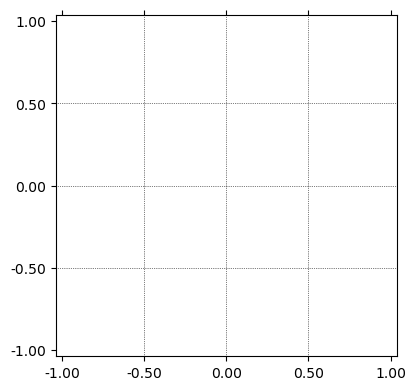

In [52]:
csigv6.plot_histogram2d(2)

 ==> creating ContextSignal with coord=(0, 0, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05ab342b80>, ctx_mask=None
contexts = ['[0.2..0.30000000000000004]', '[2.0..2.25]']
statics  = []
recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05abea1dc0>, -0.29999999999999999?*x^2*y + 0.5999

top-level root detection: 1 items in 1.74 seconds
roots = [[3.7856484422681337 .. 9.9951610954932644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([9.9951610954932643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.20 seconds
roots = [[3.7856484422681337 .. 9.9951610954932644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([9.9951610954932643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.20 seconds
roots = [[3.7856484422681337 .. 9.9951610954932644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([9.9951610954932643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.18 seconds
roots = [[3.7856484422681337 .. 9.9951610954932644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7856484422681337 .. 9.9951610954932644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([9.9951610954932643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 1.84 seconds
roots = [[3.2925135440525998 .. 8.6860024093307562]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.6860024093307561 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.17 seconds
roots = [[3.2925135440525998 .. 8.6860024093307562]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.6860024093307561 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.15 seconds
roots = [[3.2925135440525998 .. 8.6860024093307562]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.6860024093307561 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.14 seconds
roots = [[3.2925135440525998 .. 8.6860024093307562]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2925135440525998 .. 8.6860024093307562]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.6860024093307561 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05abb4adc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4adc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.63 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([4.6438005650584059 .. 6.8038631183642018], False), ([11.040017288745625 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextS

top-level root detection: 1 items in 0.29 seconds
roots = [[2.6453362072320794 .. 4.6438005650584060], [6.8038631183642017 .. 11.040017288745626]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6453362072320794 .. 4.6438005650584060], 
 [6.8038631183642017 .. 11.040017288745626]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6453362072320794 .. 4.6438005650584060], 
 [6.8038631183642017 .. 11.040017288745626]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([4.6438005650584059 .. 6.8038631183642018], False), ([11.040017288745625 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, ste

top-level root detection: 1 items in 0.26 seconds
roots = [[2.6453362072320794 .. 4.6438005650584060], [6.8038631183642017 .. 11.040017288745626]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6453362072320794 .. 4.6438005650584060], 
 [6.8038631183642017 .. 11.040017288745626]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6453362072320794 .. 4.6438005650584060], 
 [6.8038631183642017 .. 11.040017288745626]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([4.6438005650584059 .. 6.8038631183642018], False), ([11.040017288745625 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, ste

top-level root detection: 1 items in 0.20 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([6.5492231636592412 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initi

top-level root detection: 1 items in 0.52 seconds
roots = [[0.0000000000000000 .. 1.9946214291830358]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9946214291830358]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9946214291830358]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9946214291830357 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9946214291830357 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc

top-level root detection: 1 items in 0.13 seconds
roots = [[2.6319326038606711 .. 7.5176831995660365]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6319326038606711 .. 7.5176831995660365]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6319326038606711 .. 7.5176831995660365]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9946214291830357 .. 2.6319326038606712], True), ([7.5176831995660364 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9946214291830357 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc

top-level root detection: 1 items in 1.76 seconds
roots = [[1.8013781218495603 .. 6.5132867441212446]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8013781218495603 .. 6.5132867441212446]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8013781218495603 .. 6.5132867441212446]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 1.8013781218495604], True), ([6.5132867441212445 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbu

top-level root detection: 1 items in 0.12 seconds
roots = [[1.8013781218495603 .. 6.5132867441212446]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8013781218495603 .. 6.5132867441212446]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8013781218495603 .. 6.5132867441212446]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 1.8013781218495604], True), ([6.5132867441212445 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbu

top-level root detection: 1 items in 2.45 seconds
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], [0.12499999999999998 .. 5.1894344494772478]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.1521200809742584e-6 .. 0.12499999999999999], False), ([5.1894344494772477 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.20 seconds
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], [0.12499999999999998 .. 5.1894344494772478]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.1521200809742584e-6 .. 0.12499999999999999], False), ([5.1894344494772477 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.23 seconds
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], [0.12499999999999998 .. 5.1894344494772478]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.1521200809742584e-6 .. 0.12499999999999999], False), ([5.1894344494772477 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.21 seconds
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], [0.12499999999999998 .. 5.1894344494772478]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 8.1521200809742585e-6], 
 [0.12499999999999998 .. 5.1894344494772478]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.1521200809742584e-6 .. 0.12499999999999999], False), ([5.1894344494772477 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.16 seconds
roots = [[0.0000000000000000 .. 4.1756952825416658]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.1756952825416657 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.16 seconds
roots = [[0.0000000000000000 .. 4.1756952825416658]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.1756952825416657 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.15 seconds
roots = [[0.0000000000000000 .. 4.1756952825416658]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.1756952825416658]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.1756952825416657 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11a60>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11a60>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11b80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11b80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aae11ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aae11ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

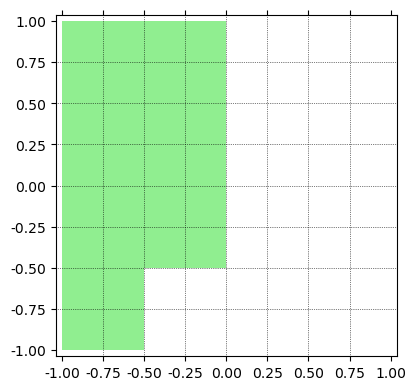

In [53]:
csigv6.plot_histogram2d(3)

 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.

top-level root detection: 1 items in 0.10 seconds
roots = [[5.5947777239771072 .. 7.9764073251497508]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5947777239771073], True), ([7.9764073251497507 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.14 seconds
roots = [[4.1093310577931285 .. 5.6801710899766125], [7.8393824459538556 .. 9.9951610954932644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1093310577931285 .. 5.6801710899766125], 
 [7.8393824459538556 .. 9.9951610954932644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1093310577931285 .. 5.6801710899766125], 
 [7.8393824459538556 .. 9.9951610954932644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([5.6801710899766124 .. 7.8393824459538557], False), ([9.9951610954932643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.14 seconds
roots = [[3.8281562153308117 .. 9.3197122489840059]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8281562153308117 .. 9.3197122489840059]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8281562153308117 .. 9.3197122489840059]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([9.3197122489840058 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obje

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 5.1790470540394403]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([5.1790470540394402 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 4.4114061385447938]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.4114061385447937 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.13 seconds
roots = [[5.4465743614987678 .. 8.9330722787826798]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4465743614987678 .. 8.9330722787826798]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4465743614987678 .. 8.9330722787826798]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4465743614987679], True), ([8.9330722787826797 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 5.1790470540394403]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([5.1790470540394402 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.10 seconds
roots = [[0.0000000000000000 .. 4.4114061385447938]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.4114061385447937 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.10 seconds
roots = [[5.4465743614987678 .. 8.9330722787826798]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4465743614987678 .. 8.9330722787826798]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4465743614987678 .. 8.9330722787826798]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4465743614987679], True), ([8.9330722787826797 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 5.1790470540394403]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 5.1790470540394403]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([5.1790470540394402 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 4.4114061385447938]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.4114061385447938]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.4114061385447937 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.03 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 3.5712788063296799]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5712788063296798 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.06 seconds
roots = [[0.0000000000000000 .. 2.7669668876263267]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.7669668876263267]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.7669668876263267]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.7669668876263266 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.13 seconds
roots = [[3.6231902562531970 .. 8.6852395975290229]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6231902562531970 .. 8.6852395975290229]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6231902562531970 .. 8.6852395975290229]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5712788063296798 .. 3.6231902562531971], True), ([8.6852395975290228 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4a940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999

top-level root detection: 1 items in 0.07 seconds
roots = [[0.0000000000000000 .. 3.5712788063296799]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5712788063296798 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.10 seconds
roots = [[3.3134006405635938 .. 8.0880869801761968]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3134006405635938 .. 8.0880869801761968]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3134006405635938 .. 8.0880869801761968]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.7669668876263266 .. 3.3134006405635939], True), ([8.0880869801761967 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.08 seconds
roots = [[0.0000000000000000 .. 3.5712788063296799]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5712788063296799]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5712788063296798 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.10 seconds
roots = [[3.3134006405635938 .. 8.0880869801761968]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3134006405635938 .. 8.0880869801761968]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3134006405635938 .. 8.0880869801761968]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.7669668876263266 .. 3.3134006405635939], True), ([8.0880869801761967 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.88 seconds
roots = [[3.8179870570615750 .. 4.6109892285274575], [9.0443331820843919 .. 11.074816734592256]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0054152046123114e-6 .. 4.1596643605374313], False), ([4.6109892285274574 .. 9.0443331820843920], False), ([11.074816734592255 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.12 seconds
roots = [[3.8179870570615750 .. 4.6109892285274575], [9.0443331820843919 .. 11.074816734592256]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0054152046123114e-6 .. 4.1596643605374313], False), ([4.6109892285274574 .. 9.0443331820843920], False), ([11.074816734592255 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.12 seconds
roots = [[3.8179870570615750 .. 4.6109892285274575], [9.0443331820843919 .. 11.074816734592256]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0054152046123114e-6 .. 4.1596643605374313], False), ([4.6109892285274574 .. 9.0443331820843920], False), ([11.074816734592255 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.11 seconds
roots = [[3.8179870570615750 .. 4.6109892285274575], [9.0443331820843919 .. 11.074816734592256]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8179870570615750 .. 4.6109892285274575], 
 [9.0443331820843919 .. 11.074816734592256]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0054152046123114e-6 .. 4.1596643605374313], False), ([4.6109892285274574 .. 9.0443331820843920], False), ([11.074816734592255 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.70 seconds
roots = [[3.4965871459040034 .. 4.3519489591641865], [8.4661573634967375 .. 10.327051904732369]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4965871459040034 .. 4.3519489591641865], 
 [8.4661573634967375 .. 10.327051904732369]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4965871459040034 .. 4.3519489591641865], 
 [8.4661573634967375 .. 10.327051904732369]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5175903588497252e-7 .. 3.3973708866602972], False), ([4.3519489591641864 .. 8.4661573634967376], False), ([10.327051904732368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5175903588497252e-7 .. 3.3973708866602972], False), ([4.3519489591641864 .. 8.4661573634967376], False), ([10.327051904732368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab3013a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab3013a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.18 seconds
roots = [[4.7637419303756391 .. 7.5371061835950961]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7637419303756392], False), ([7.5371061835950960 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.21 seconds
roots = [[4.7637419303756391 .. 7.5371061835950961]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7637419303756392], False), ([7.5371061835950960 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.17 seconds
roots = [[4.7637419303756391 .. 7.5371061835950961]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7637419303756391 .. 7.5371061835950961]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7637419303756392], False), ([7.5371061835950960 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.13 seconds
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], [2.4422375987732158 .. 5.0618412337362733]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4218759481962798e-6 .. 2.4422375987732159], False), ([5.0618412337362732 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], [1.6913718269344863 .. 4.4554352631470460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4294263547280094e-6 .. 1.6913718269344864], False), ([4.4554352631470459 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.15 seconds
roots = [[4.4072329342407723 .. 6.5487654026827862]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.4072329342407724], False), ([6.5487654026827861 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.12 seconds
roots = [[3.7803063293392211 .. 5.8188121798426993]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.7803063293392212], False), ([5.8188121798426992 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.13 seconds
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], [2.4422375987732158 .. 5.0618412337362733]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4218759481962798e-6 .. 2.4422375987732159], False), ([5.0618412337362732 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], [1.6913718269344863 .. 4.4554352631470460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4294263547280094e-6 .. 1.6913718269344864], False), ([4.4554352631470459 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.16 seconds
roots = [[4.4072329342407723 .. 6.5487654026827862]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.4072329342407724], False), ([6.5487654026827861 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.12 seconds
roots = [[3.7803063293392211 .. 5.8188121798426993]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.7803063293392212], False), ([5.8188121798426992 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.18 seconds
roots = [[3.2043230159091788 .. 4.2740279499301615], [7.5881151017879888 .. 9.9138076845314274]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2043230159091788 .. 4.2740279499301615], 
 [7.5881151017879888 .. 9.9138076845314274]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2043230159091788 .. 4.2740279499301615], 
 [7.5881151017879888 .. 9.9138076845314274]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4218759481962798e-6 .. 2.4422375987732159], False), ([4.2740279499301614 .. 7.5881151017879889], False), ([9.9138076845314273 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.15 seconds
roots = [[2.8783762407316655 .. 3.9975927956821944], [7.1372042205513430 .. 9.3133806872912289]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 3.9975927956821944], 
 [7.1372042205513430 .. 9.3133806872912289]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 3.9975927956821944], 
 [7.1372042205513430 .. 9.3133806872912289]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4294263547280094e-6 .. 1.6913718269344864], False), ([3.9975927956821943 .. 7.1372042205513431], False), ([9.3133806872912288 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1037727380071374], False), ([11.037429650137028 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 3), signal = <functi

top-level root detection: 1 items in 0.14 seconds
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], [2.4422375987732158 .. 5.0618412337362733]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4218759481962799e-6], 
 [2.4422375987732158 .. 5.0618412337362733]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4218759481962798e-6 .. 2.4422375987732159], False), ([5.0618412337362732 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.14 seconds
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], [1.6913718269344863 .. 4.4554352631470460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.4294263547280095e-6], 
 [1.6913718269344863 .. 4.4554352631470460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.4294263547280094e-6 .. 1.6913718269344864], False), ([4.4554352631470459 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000

top-level root detection: 1 items in 0.13 seconds
roots = [[4.4072329342407723 .. 6.5487654026827862]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4072329342407723 .. 6.5487654026827862]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.4072329342407724], False), ([6.5487654026827861 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.12 seconds
roots = [[3.7803063293392211 .. 5.8188121798426993]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7803063293392211 .. 5.8188121798426993]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.7803063293392212], False), ([5.8188121798426992 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.11 seconds
roots = [[3.0367072096408453 .. 7.4910391253565499]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9835938203951493 .. 3.0367072096408454], True), ([7.4910391253565498 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.09 seconds
roots = [[3.0367072096408453 .. 7.4910391253565499]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9835938203951493 .. 3.0367072096408454], True), ([7.4910391253565498 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.08 seconds
roots = [[3.0367072096408453 .. 7.4910391253565499]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9835938203951493 .. 3.0367072096408454], True), ([7.4910391253565498 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.03 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.09 seconds
roots = [[3.0367072096408453 .. 7.4910391253565499]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0367072096408453 .. 7.4910391253565499]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9835938203951493 .. 3.0367072096408454], True), ([7.4910391253565498 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrum

top-level root detection: 1 items in 0.03 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.09 seconds
roots = [[1.8388458279982136 .. 6.1169761325179089]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8388458279982136 .. 6.1169761325179089]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8388458279982136 .. 6.1169761325179089]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.9025319526788663e-6 .. 1.8388458279982137], True), ([6.1169761325179088 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, inst

top-level root detection: 1 items in 0.09 seconds
roots = [[2.2875708349806682 .. 6.5132867441212446]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2875708349806682 .. 6.5132867441212446]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2875708349806682 .. 6.5132867441212446]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 2.2875708349806683], True), ([6.5132867441212445 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instru

top-level root detection: 1 items in 0.03 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree =

top-level root detection: 1 items in 0.08 seconds
roots = [[1.8388458279982136 .. 6.1169761325179089]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8388458279982136 .. 6.1169761325179089]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8388458279982136 .. 6.1169761325179089]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.9025319526788663e-6 .. 1.8388458279982137], True), ([6.1169761325179088 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, inst

top-level root detection: 1 items in 0.08 seconds
roots = [[2.2875708349806682 .. 6.5132867441212446]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2875708349806682 .. 6.5132867441212446]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2875708349806682 .. 6.5132867441212446]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.35256250000000011 .. 2.2875708349806683], True), ([6.5132867441212445 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instru

top-level root detection: 1 items in 0.10 seconds
roots = [[0.0000000000000000 .. 3.6085148781779314e-6], [0.91298015656249931 .. 3.8620544030310251]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.6085148781779314e-6], 
 [0.91298015656249931 .. 3.8620544030310251]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.6085148781779314e-6], 
 [0.91298015656249931 .. 3.8620544030310251]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.6085148781779313e-6 .. 0.91298015656249932], False), ([3.8620544030310250 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000

top-level root detection: 1 items in 0.10 seconds
roots = [[0.0000000000000000 .. 7.7733196966367732e-6], [0.19531865823769786 .. 3.3990443332175171]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 7.7733196966367732e-6], 
 [0.19531865823769786 .. 3.3990443332175171]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 7.7733196966367732e-6], 
 [0.19531865823769786 .. 3.3990443332175171]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([7.7733196966367731e-6 .. 0.19531865823769787], False), ([3.3990443332175170 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000

 ==> creating ContextSignal with coord=(1, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.r

top-level root detection: 1 items in 0.08 seconds
roots = [[2.0103828476727492 .. 2.6678529171717230], [7.6416698317221110 .. 9.2258182659572797]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0103828476727492 .. 2.6678529171717230], 
 [7.6416698317221110 .. 9.2258182659572797]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0103828476727492 .. 2.6678529171717230], 
 [7.6416698317221110 .. 9.2258182659572797]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.6416698317221111], False), ([9.2258182659572796 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.10 seconds
roots = [[2.5853772267601740 .. 3.6891757267999479], [6.6761540455081256 .. 8.7040024472183717]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5853772267601740 .. 3.6891757267999479], 
 [6.6761540455081256 .. 8.7040024472183717]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5853772267601740 .. 3.6891757267999479], 
 [6.6761540455081256 .. 8.7040024472183717]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.6085148781779313e-6 .. 0.91298015656249932], False), ([3.6891757267999478 .. 6.6761540455081257], False), ([8.7040024472183716 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order

top-level root detection: 1 items in 0.10 seconds
roots = [[2.2331468843895430 .. 3.3896475571614327], [6.2607401517041987 .. 8.1824912901768645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2331468843895430 .. 3.3896475571614327], 
 [6.2607401517041987 .. 8.1824912901768645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2331468843895430 .. 3.3896475571614327], 
 [6.2607401517041987 .. 8.1824912901768645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([7.7733196966367731e-6 .. 0.19531865823769787], False), ([3.3896475571614326 .. 6.2607401517041988], False), ([8.1824912901768644 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order

top-level root detection: 1 items in 0.09 seconds
roots = [[2.8783762407316655 .. 4.6630210481961161]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 4.6630210481961161]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 4.6630210481961161]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.8783762407316656], False), ([4.6630210481961160 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.6085148781779313e-6 .. 0.91298015656249932], False), ([3.8620544030310250 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada

top-level root detection: 1 items in 0.09 seconds
roots = [[3.3355890776932852 .. 5.1734062700683588]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3355890776932852 .. 5.1734062700683588]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3355890776932852 .. 5.1734062700683588]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3355890776932853], False), ([5.1734062700683587 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.08 seconds
roots = [[2.0103828476727492 .. 2.6678529171717230], [7.6416698317221110 .. 9.2258182659572797]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0103828476727492 .. 2.6678529171717230], 
 [7.6416698317221110 .. 9.2258182659572797]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0103828476727492 .. 2.6678529171717230], 
 [7.6416698317221110 .. 9.2258182659572797]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.6416698317221111], False), ([9.2258182659572796 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.10 seconds
roots = [[2.5853772267601740 .. 3.6891757267999479], [6.6761540455081256 .. 8.7040024472183717]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5853772267601740 .. 3.6891757267999479], 
 [6.6761540455081256 .. 8.7040024472183717]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5853772267601740 .. 3.6891757267999479], 
 [6.6761540455081256 .. 8.7040024472183717]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.6085148781779313e-6 .. 0.91298015656249932], False), ([3.6891757267999478 .. 6.6761540455081257], False), ([8.7040024472183716 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order

top-level root detection: 1 items in 0.10 seconds
roots = [[2.2331468843895430 .. 3.3896475571614327], [6.2607401517041987 .. 8.1824912901768645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2331468843895430 .. 3.3896475571614327], 
 [6.2607401517041987 .. 8.1824912901768645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2331468843895430 .. 3.3896475571614327], 
 [6.2607401517041987 .. 8.1824912901768645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([7.7733196966367731e-6 .. 0.19531865823769787], False), ([3.3896475571614326 .. 6.2607401517041988], False), ([8.1824912901768644 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order

top-level root detection: 1 items in 0.11 seconds
roots = [[2.3441911009951810 .. 2.9447902028140245], [8.1208869221512181 .. 8.1210442948186348], [8.1218588974728405 .. 9.7081705368363398]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3441911009951810 .. 2.9447902028140245], 
 [8.1208869221512181 .. 8.1210442948186348], 
 [8.1218588974728405 .. 9.7081705368363398]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3441911009951810 .. 2.9447902028140245], 
 [8.1208869221512181 .. 8.1210442948186348], 
 [8.1218588974728405 .. 9.7081705368363398]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.1208869221512182], False), ([8.1210442948186347 .. 8.1218588974728406], False), ([9.7081705368363397 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 2.9186353528303189]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.9186353528303189]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.9186353528303189]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.9186353528303188 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aba462e0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.07 seconds
roots = [[0.0000000000000000 .. 2.5296253997981744]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.5296253997981744]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.5296253997981744]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.529625399798

top-level root detection: 1 items in 0.07 seconds
roots = [[2.5051017934716890 .. 4.1603416649630934]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5051017934716890 .. 4.1603416649630934]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5051017934716890 .. 4.1603416649630934]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.5051017934716891], False), ([4.1603416649630933 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.07 seconds
roots = [[1.3623314026061614 .. 1.9579388063672066], [6.9486009944866733 .. 8.3550403875159721]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3623314026061614 .. 1.9579388063672066], 
 [6.9486009944866733 .. 8.3550403875159721]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3623314026061614 .. 1.9579388063672066], 
 [6.9486009944866733 .. 8.3550403875159721]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.9486009944866734], False), ([8.3550403875159720 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.08 seconds
roots = [[0.0000000000000000 .. 2.5296253997981744]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.5296253997981744]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.5296253997981744]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.5296253997981743 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.06 seconds
roots = [[1.6896219314351512 .. 2.3268101792861744], [7.3131737801125540 .. 8.7289573784710886]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6896219314351512 .. 2.3268101792861744], 
 [7.3131737801125540 .. 8.7289573784710886]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6896219314351512 .. 2.3268101792861744], 
 [7.3131737801125540 .. 8.7289573784710886]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.3131737801125541], False), ([8.7289573784710885 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.08 seconds
roots = [[0.0000000000000000 .. 2.9186353528303189]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.9186353528303189]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.9186353528303189]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.9186353528303188 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric obj

top-level root detection: 1 items in 0.08 seconds
roots = [[1.5320925953468200 .. 2.5296253997981744], [5.6367640544995287 .. 7.3648164775414325]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5320925953468200 .. 2.5296253997981744], 
 [5.6367640544995287 .. 7.3648164775414325]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5320925953468200 .. 2.5296253997981744], 
 [5.6367640544995287 .. 7.3648164775414325]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.5296253997981743 .. 5.6367640544995288], False), ([7.3648164775414324 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.07 seconds
roots = [[2.1403512384609628 .. 3.7594654141724391]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1403512384609628 .. 3.7594654141724391]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1403512384609628 .. 3.7594654141724391]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.1403512384609629], False), ([3.7594654141724390 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.08 seconds
roots = [[1.8809877698374519 .. 2.9517158815227585], [5.9436264394106741 .. 7.7348859040142273]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8809877698374519 .. 2.9517158815227585], 
 [5.9436264394106741 .. 7.7348859040142273]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8809877698374519 .. 2.9517158815227585], 
 [5.9436264394106741 .. 7.7348859040142273]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.9517158815227584 .. 5.9436264394106742], False), ([7.7348859040142272 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.08 seconds
roots = [[2.5051017934716890 .. 4.1603416649630934]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5051017934716890 .. 4.1603416649630934]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5051017934716890 .. 4.1603416649630934]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.5051017934716891], False), ([4.1603416649630933 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.06 seconds
roots = [[1.3623314026061614 .. 1.9579388063672066], [6.9486009944866733 .. 8.3550403875159721]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3623314026061614 .. 1.9579388063672066], 
 [6.9486009944866733 .. 8.3550403875159721]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3623314026061614 .. 1.9579388063672066], 
 [6.9486009944866733 .. 8.3550403875159721]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.9486009944866734], False), ([8.3550403875159720 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab3015e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab3015e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301b80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301b80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301a60>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301a60>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05ab301dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ab301dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 2.15 seconds
roots = [[3.9941989162547204 .. 6.1018406676513335]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9941989162547204 .. 6.1018406676513335]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9941989162547204 .. 6.1018406676513335]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05ab301dc0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.

top-level root detection: 1 items in 3.24 seconds
roots = [[4.2870778875256272 .. 6.7096261255530268]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.25 seconds
roots = [[4.2870778875256272 .. 6.7096261255530268]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.22 seconds
roots = [[4.2870778875256272 .. 6.7096261255530268]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.19 seconds
roots = [[4.2870778875256272 .. 6.7096261255530268]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2870778875256272 .. 6.7096261255530268]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.77 seconds
roots = [[2.9175945011848831 .. 4.4130189717675857]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9175945011848831 .. 4.4130189717675857]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9175945011848831 .. 4.4130189717675857]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree

top-level root detection: 1 items in 0.08 seconds
roots = [[2.9175945011848831 .. 4.4130189717675857]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9175945011848831 .. 4.4130189717675857]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9175945011848831 .. 4.4130189717675857]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree

top-level root detection: 1 items in 0.10 seconds
roots = [[3.1893402520865667 .. 4.7372805517338055]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1893402520865667 .. 4.7372805517338055]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1893402520865667 .. 4.7372805517338055]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c55464c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c55464c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.21 seconds
roots = [[3.4085225698169403 .. 5.0631514806524197]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4085225698169403 .. 5.0631514806524197]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4085225698169403 .. 5.0631514806524197]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.13 seconds
roots = [[3.4085225698169403 .. 5.0631514806524197]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4085225698169403 .. 5.0631514806524197]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4085225698169403 .. 5.0631514806524197]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05ab56fac0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumenta

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree 

top-level root detection: 1 items in 0.15 seconds
roots = [[3.6238326797846194 .. 5.4071823486396991]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238326797846194 .. 5.4071823486396991]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238326797846194 .. 5.4071823486396991]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 1.78 seconds
roots = [[2.4050182167260327 .. 3.1473430227760622], [8.8127018381806649 .. 11.540316254522369]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8127018381806650], False), ([11.540316254522368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.19 seconds
roots = [[2.4050182167260327 .. 3.1473430227760622], [8.8127018381806649 .. 11.540316254522369]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8127018381806650], False), ([11.540316254522368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.17 seconds
roots = [[2.4050182167260327 .. 3.1473430227760622], [8.8127018381806649 .. 11.540316254522369]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8127018381806650], False), ([11.540316254522368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.17 seconds
roots = [[2.4050182167260327 .. 3.1473430227760622], [8.8127018381806649 .. 11.540316254522369]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4050182167260327 .. 3.1473430227760622], 
 [8.8127018381806649 .. 11.540316254522369]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8127018381806650], False), ([11.540316254522368 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 1.25 seconds
roots = [[2.0760252235250278 .. 2.6812644388902554], [8.4588029855695356 .. 10.707933009132436]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4588029855695357], False), ([10.707933009132435 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.14 seconds
roots = [[2.0760252235250278 .. 2.6812644388902554], [8.4588029855695356 .. 10.707933009132436]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4588029855695357], False), ([10.707933009132435 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.13 seconds
roots = [[2.0760252235250278 .. 2.6812644388902554], [8.4588029855695356 .. 10.707933009132436]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4588029855695357], False), ([10.707933009132435 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

top-level root detection: 1 items in 0.16 seconds
roots = [[2.0760252235250278 .. 2.6812644388902554], [8.4588029855695356 .. 10.707933009132436]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0760252235250278 .. 2.6812644388902554], 
 [8.4588029855695356 .. 10.707933009132436]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4588029855695357], False), ([10.707933009132435 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546b80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546b80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.12 seconds
roots = [[3.6029591121840485 .. 5.5896972253388082]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.6029591121840486], False), ([5.5896972253388081 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.11 seconds
roots = [[3.6029591121840485 .. 5.5896972253388082]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.6029591121840486], False), ([5.5896972253388081 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

top-level root detection: 1 items in 0.11 seconds
roots = [[3.6029591121840485 .. 5.5896972253388082]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6029591121840485 .. 5.5896972253388082]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.6029591121840486], False), ([5.5896972253388081 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.12 seconds
roots = [[3.2577205874873400 .. 5.0422465902856822]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2577205874873400 .. 5.0422465902856822]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2577205874873400 .. 5.0422465902856822]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.2577205874873401], False), ([5.0422465902856821 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instr

roots = [[3.2577205874873400 .. 5.0422465902856822]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.2577205874873401], False), ([5.0422465902856821 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05ab342b80>, ctx_mask=None
recomputing re

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.7897482519218580], False), ([9.5144160963657071 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 3), signal = <functi

top-level root detection: 1 items in 0.10 seconds
roots = [[1.4078465907246515 .. 1.8799883966783245], [7.7897482519218579 .. 9.5144160963657072]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4078465907246515 .. 1.8799883966783245], 
 [7.7897482519218579 .. 9.5144160963657072]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4078465907246515 .. 1.8799883966783245], 
 [7.7897482519218579 .. 9.5144160963657072]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.7897482519218580], False), ([9.5144160963657071 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precond

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05c5546ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a3a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a3a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 2.63 seconds
roots = [[3.8142827027166252 .. 5.8205719128150460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.18 seconds
roots = [[3.8142827027166252 .. 5.8205719128150460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.19 seconds
roots = [[3.8142827027166252 .. 5.8205719128150460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.23 seconds
roots = [[3.8142827027166252 .. 5.8205719128150460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8142827027166252 .. 5.8205719128150460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 3.79 seconds
roots = [[3.9999594115135677 .. 6.2854360547814264]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.21 seconds
roots = [[3.9999594115135677 .. 6.2854360547814264]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
signal given bool roots: 1 items in 0.01 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.19 seconds
roots = [[3.9999594115135677 .. 6.2854360547814264]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

top-level root detection: 1 items in 0.19 seconds
roots = [[3.9999594115135677 .. 6.2854360547814264]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9999594115135677 .. 6.2854360547814264]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = None, ctx_

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a4c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a4c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

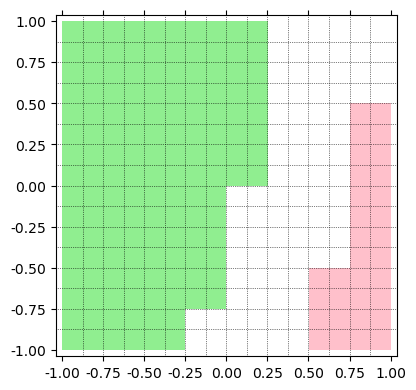

In [54]:
csigv6.plot_histogram2d(4)

 ==> creating ContextSignal with coord=(0, 0, 0, 0, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.599999999

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_orde

top-level root detection: 1 items in 0.06 seconds
roots = [[5.5947777239771072 .. 7.9764073251497508]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5947777239771073], True), ([7.9764073251497507 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.07 seconds
roots = [[4.7293798989603477 .. 5.5947777239771864], [8.4174017149519126 .. 9.4968871642141793]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7293798989603477 .. 5.5947777239771864], 
 [8.4174017149519126 .. 9.4968871642141793]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7293798989603477 .. 5.5947777239771864], 
 [8.4174017149519126 .. 9.4968871642141793]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.85984562832200185], True), ([4.4114061385447937 .. 4.7293798989603478], True), ([5.5947777239771863 .. 8.4174017149519127], False), ([9.4968871642141792 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y

top-level root detection: 1 items in 0.07 seconds
roots = [[0.0000000000000000 .. 0.98749225612908953], [3.8699728452597983 .. 5.1790470540394403]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 0.98749225612908953], 
 [3.8699728452597983 .. 5.1790470540394403]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 0.98749225612908953], 
 [3.8699728452597983 .. 5.1790470540394403]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.98749225612908952 .. 3.8699728452597984], False), ([5.1790470540394402 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.06 seconds
roots = [[4.1451699762298055 .. 4.8468202346351488], [8.7371706466303251 .. 9.6383296415354192]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1451699762298055 .. 4.8468202346351488], 
 [8.7371706466303251 .. 9.6383296415354192]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1451699762298055 .. 4.8468202346351488], 
 [8.7371706466303251 .. 9.6383296415354192]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.1674019075854848 .. 3.2811962470167134], False), ([4.8468202346351487 .. 8.7371706466303252], False), ([9.6383296415354191 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.10 seconds
roots = [[4.4867398276501999 .. 8.4540762437305670]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4867398276501999 .. 8.4540762437305670]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4867398276501999 .. 8.4540762437305670]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.5054518833851267], True), ([2.5737915030148044 .. 4.4867398276502000], True), ([8.4540762437305669 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshol

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 4.0064945068748222]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.0064945068748222]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.0064945068748222]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.0064945068748221 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.02 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_

roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t'

 ==> creating ContextSignal with coord=(0, 0, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.7271374412762147], True), ([7.3151185116180306 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res 

top-level root detection: 1 items in 0.07 seconds
roots = [[0.97843772334664325 .. 3.8856055982074205]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.97843772334664325 .. 3.8856055982074205]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.97843772334664325 .. 3.8856055982074205]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.97843772334664326], True), ([3.8856055982074204 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=Tr

=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05ab1696d0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.98749225612908952 .. 3.8699728452597984], False), ([4.9610978583839839 .. 9.1051948032097610], False), ([9.9881226854895306 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 2, 2), signal = Signal([

top-level root detection: 1 items in 0.08 seconds
roots = [[4.5844720980314921 .. 5.8356297127785686], [7.2099807831951903 .. 8.7642814229263486]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5844720980314921 .. 5.8356297127785686], 
 [7.2099807831951903 .. 8.7642814229263486]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5844720980314921 .. 5.8356297127785686], 
 [7.2099807831951903 .. 8.7642814229263486]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.1559784370141871], True), ([3.3123763573409958 .. 4.5844720980314922], True), ([5.8356297127785685 .. 7.2099807831951904], False), ([8.7642814229263485 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y 

top-level root detection: 1 items in 0.08 seconds
roots = [[0.0000000000000000 .. 1.5861784150585397], [2.4806807488137980 .. 4.3768184856735984]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.5861784150585397], 
 [2.4806807488137980 .. 4.3768184856735984]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.5861784150585397], 
 [2.4806807488137980 .. 4.3768184856735984]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.5861784150585396 .. 2.4806807488137981], False), ([4.3768184856735983 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), 

top-level root detection: 1 items in 0.07 seconds
roots = [[3.9070139448883489 .. 4.7523759174873508], [7.8749512118157358 .. 9.0303279623951376]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9070139448883489 .. 4.7523759174873508], 
 [7.8749512118157358 .. 9.0303279623951376]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9070139448883489 .. 4.7523759174873508], 
 [7.8749512118157358 .. 9.0303279623951376]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.7523759174873507 .. 7.8749512118157359], False), ([9.0303279623951375 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.08 seconds
roots = [[5.4510997329957895 .. 8.9330722787826798]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4510997329957895 .. 8.9330722787826798]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4510997329957895 .. 8.9330722787826798]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4510997329957896], True), ([8.9330722787826797 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.05 seconds
roots = [[5.5947777239771072 .. 7.9764073251497508]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5947777239771072 .. 7.9764073251497508]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5947777239771073], True), ([7.9764073251497507 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.06 seconds
roots = [[4.7293798989603477 .. 5.5947777239771864], [8.4174017149519126 .. 9.4968871642141793]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7293798989603477 .. 5.5947777239771864], 
 [8.4174017149519126 .. 9.4968871642141793]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7293798989603477 .. 5.5947777239771864], 
 [8.4174017149519126 .. 9.4968871642141793]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.85984562832200185], True), ([4.4114061385447937 .. 4.7293798989603478], True), ([5.5947777239771863 .. 8.4174017149519127], False), ([9.4968871642141792 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y

top-level root detection: 1 items in 0.07 seconds
roots = [[0.0000000000000000 .. 0.98749225612908953], [3.8699728452597983 .. 5.1790470540394403]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 0.98749225612908953], 
 [3.8699728452597983 .. 5.1790470540394403]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 0.98749225612908953], 
 [3.8699728452597983 .. 5.1790470540394403]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.98749225612908952 .. 3.8699728452597984], False), ([5.1790470540394402 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05ab817190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.1674019075854848 .. 3.2811962470167134], False), ([4.8468202346351487 .. 8.7371706466303252], 

var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05abea1dc0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * 

top-level root detection: 1 items in 0.06 seconds
roots = [[4.0122734686896235 .. 4.7973494018434453], [8.3127300448961793 .. 9.3128972885499409]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0122734686896235 .. 4.7973494018434453], 
 [8.3127300448961793 .. 9.3128972885499409]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0122734686896235 .. 4.7973494018434453], 
 [8.3127300448961793 .. 9.3128972885499409]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.5861784150585396 .. 2.4806807488137981], False), ([4.7973494018434452 .. 8.3127300448961794], False), ([9.3128972885499408 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[7.1697153714271593 .. 7.5834878203034411]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[7.1697153714271593 .. 7.5834878203034411]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[7.1697153714271593 .. 7.5834878203034411]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.1697153714271594], True), ([7.5834878203034410 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.07 seconds
roots = [[5.5171473912503579 .. 8.4546001241972207]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5171473912503579 .. 8.4546001241972207]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5171473912503579 .. 8.4546001241972207]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5171473912503580], True), ([8.4546001241972206 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.04 seconds
roots = [[5.7271374412762146 .. 7.3151185116180307]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7271374412762146 .. 7.3151185116180307]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7271374412762146 .. 7.3151185116180307]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.7271374412762147], True), ([7.3151185116180306 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.08 seconds
roots = [[0.97843772334664325 .. 3.8856055982074205]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.97843772334664325 .. 3.8856055982074205]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.97843772334664325 .. 3.8856055982074205]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.97843772334664326], True), ([3.8856055982074204 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=Tr

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abea1dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.09 seconds
roots = [[4.5844720980314921 .. 5.8356297127785686], [7.2099807831951903 .. 8.7642814229263486]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5844720980314921 .. 5.8356297127785686], 
 [7.2099807831951903 .. 8.7642814229263486]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5844720980314921 .. 5.8356297127785686], 
 [7.2099807831951903 .. 8.7642814229263486]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.1559784370141871], True), ([3.3123763573409958 .. 4.5844720980314922], True), ([5.8356297127785685 .. 7.2099807831951904], False), ([8.7642814229263485 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 0), signal = functool

top-level root detection: 1 items in 0.09 seconds
roots = [[4.4867398276501999 .. 8.4540762437305670]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4867398276501999 .. 8.4540762437305670]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4867398276501999 .. 8.4540762437305670]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.5054518833851267], True), ([2.5737915030148044 .. 4.4867398276502000], True), ([8.4540762437305669 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshol

top-level root detection: 1 items in 0.07 seconds
roots = [[0.0000000000000000 .. 4.0064945068748222]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.0064945068748222]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 4.0064945068748222]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.0064945068748221 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

 ==> creating ContextSignal with coord=(0, 1, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4a940>, (([0.5999999999 , 0.6

top-level root detection: 1 items in 0.07 seconds
roots = [[4.3824763142068965 .. 7.6173906635412605]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3824763142068965 .. 7.6173906635412605]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3824763142068965 .. 7.6173906635412605]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.3824763142068966], True), ([7.6173906635412604 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.06 seconds
roots = [[0.0000000000000000 .. 3.1667886368876346]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.1667886368876346]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.1667886368876346]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.1667886368876345 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05ab72b430>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.5000000

top-level root detection: 1 items in 0.04 seconds
roots = [[0.0000000000000000 .. 2.3718434412049221]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.3718434412049221]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.3718434412049221]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.3718434412049220 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

observer = <flowstar.observers.RestrictedObserver object at 0x7f05ab6b6190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None

top-level root detection: 1 items in 0.07 seconds
roots = [[4.3824763142068965 .. 7.6173906635412605]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3824763142068965 .. 7.6173906635412605]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3824763142068965 .. 7.6173906635412605]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.3824763142068966], True), ([7.6173906635412604 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

 ==> creating ContextSignal with coord=(0, 1, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowsta

top-level root detection: 1 items in 0.06 seconds
roots = [[4.1633381304418417 .. 6.9204328795318997]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1633381304418417 .. 6.9204328795318997]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1633381304418417 .. 6.9204328795318997]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.1633381304418418], True), ([6.9204328795318996 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.06 seconds
roots = [[3.3796973798791247 .. 4.4406896796043807], [6.4263320281439533 .. 7.7981417910480762]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3796973798791247 .. 4.4406896796043807], 
 [6.4263320281439533 .. 7.7981417910480762]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3796973798791247 .. 4.4406896796043807], 
 [6.4263320281439533 .. 7.7981417910480762]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.3718434412049220 .. 3.3796973798791248], True), ([4.4406896796043806 .. 6.4263320281439534], False), ([7.7981417910480761 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = [[0.0000000000000000 .. 3.5677598010801437]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5677598010801437]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.5677598010801437]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5677598010801436 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.02 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.05 seconds
roots = [[0.0000000000000000 .. 2.7669668876263267]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.7669668876263267]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 2.7669668876263267]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.7669668876263266 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05abb4a940>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * 

top-level root detection: 1 items in 0.09 seconds
roots = [[4.4443064716668656 .. 8.0189310207357849]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4443064716668656 .. 8.0189310207357849]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4443064716668656 .. 8.0189310207357849]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.4443064716668657], True), ([8.0189310207357848 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.05 seconds
roots = [[3.7923295531933747 .. 4.6440394961724714], [7.6009141221417220 .. 8.6639916743620074]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7923295531933747 .. 4.6440394961724714], 
 [7.6009141221417220 .. 8.6639916743620074]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7923295531933747 .. 4.6440394961724714], 
 [7.6009141221417220 .. 8.6639916743620074]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5677598010801436 .. 3.7923295531933748], True), ([4.6440394961724713 .. 7.6009141221417221], False), ([8.6639916743620073 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

top-level root detection: 1 items in 0.08 seconds
roots = [[4.2894778235925850 .. 7.2529047652199994]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2894778235925850 .. 7.2529047652199994]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2894778235925850 .. 7.2529047652199994]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.2894778235925851], True), ([7.2529047652199993 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.07 seconds
roots = [[3.5181751517776955 .. 4.5021246695041058], [6.7964189192578681 .. 8.0489853919802759]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5181751517776955 .. 4.5021246695041058], 
 [6.7964189192578681 .. 8.0489853919802759]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5181751517776955 .. 4.5021246695041058], 
 [6.7964189192578681 .. 8.0489853919802759]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.7669668876263266 .. 3.5181751517776956], True), ([4.5021246695041057 .. 6.7964189192578682], False), ([8.0489853919802758 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

top-level root detection: 1 items in 0.03 seconds
roots = [[4.1110219286323550 .. 4.5563679952173289], [9.4458652217272280 .. 10.572818141604503]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1110219286323550 .. 4.5563679952173289], 
 [9.4458652217272280 .. 10.572818141604503]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1110219286323550 .. 4.5563679952173289], 
 [9.4458652217272280 .. 10.572818141604503]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.3323433398667053e-7 .. 9.4458652217272281], False), ([10.572818141604502 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000)

top-level root detection: 1 items in 0.03 seconds
roots = [[5.0434670483515109 .. 6.1311618261534440]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0434670483515109 .. 6.1311618261534440]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0434670483515109 .. 6.1311618261534440]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.0434670483515110], False), ([6.1311618261534439 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.04 seconds
roots = [[3.9854090069286089 .. 4.4305024418302228], [9.1082898830016052 .. 10.126720715592170]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9854090069286089 .. 4.4305024418302228], 
 [9.1082898830016052 .. 10.126720715592170]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9854090069286089 .. 4.4305024418302228], 
 [9.1082898830016052 .. 10.126720715592170]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.8615223975506101e-7 .. 4.2083870493059959], False), ([4.4305024418302227 .. 9.1082898830016053], False), ([10.126720715592169 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, 

top-level root detection: 1 items in 0.04 seconds
roots = [[0.0000000000000000 .. 3.3323433398667054e-7], [4.5963950272611846 .. 5.8774664009007172]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.3323433398667054e-7], 
 [4.5963950272611846 .. 5.8774664009007172]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 3.3323433398667054e-7], 
 [4.5963950272611846 .. 5.8774664009007172]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.3323433398667053e-7 .. 4.5963950272611847], False), ([5.8774664009007171 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000

top-level root detection: 1 items in 0.03 seconds
roots = [[4.0040047813325569 .. 4.3332657599454692], [10.103068957101660 .. 11.069425721213694]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0040047813325569 .. 4.3332657599454692], 
 [10.103068957101660 .. 11.069425721213694]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0040047813325569 .. 4.3332657599454692], 
 [10.103068957101660 .. 11.069425721213694]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.103068957101661], False), ([11.069425721213693 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.03 seconds
roots = [[3.9854090069286089 .. 4.4305024418302228], [9.1082898830016052 .. 10.126720715592170]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9854090069286089 .. 4.4305024418302228], 
 [9.1082898830016052 .. 10.126720715592170]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9854090069286089 .. 4.4305024418302228], 
 [9.1082898830016052 .. 10.126720715592170]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.8615223975506101e-7 .. 4.2083870493059959], False), ([4.4305024418302227 .. 9.1082898830016053], False), ([10.126720715592169 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, 

top-level root detection: 1 items in 0.03 seconds
roots = [[0.0000000000000000 .. 6.7640026985926751e-7], [3.8357005645344099 .. 5.1053518992002110]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 6.7640026985926751e-7], 
 [3.8357005645344099 .. 5.1053518992002110]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 6.7640026985926751e-7], 
 [3.8357005645344099 .. 5.1053518992002110]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([6.7640026985926750e-7 .. 3.8357005645344100], False), ([5.1053518992002109 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000

top-level root detection: 1 items in 0.03 seconds
roots = [[4.3199069468728295 .. 5.3917470403985917]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3199069468728295 .. 5.3917470403985917]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3199069468728295 .. 5.3917470403985917]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.3199069468728296], False), ([5.3917470403985916 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

 ==> creating ContextSignal with coord=(0, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0063459208182449e-7 .. 3.4464816125105183], False), ([4.1953031482850189 .. 8.5103312469707149], False), ([9.5058771842836851 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1, 2), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 1, 2), signal = functools.par

top-level root detection: 1 items in 0.03 seconds
roots = [[3.8235452831057630 .. 4.3094361727947846], [8.8306936362345691 .. 9.8141340076289599]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8235452831057630 .. 4.3094361727947846], 
 [8.8306936362345691 .. 9.8141340076289599]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8235452831057630 .. 4.3094361727947846], 
 [8.8306936362345691 .. 9.8141340076289599]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([6.7640026985926750e-7 .. 3.8357005645344100], False), ([4.3094361727947845 .. 8.8306936362345692], False), ([9.8141340076289598 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, 

top-level root detection: 1 items in 0.03 seconds
roots = [[3.5033167988883837 .. 3.9144430669639659], [9.0975685783092039 .. 10.020030468780455]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5033167988883837 .. 3.9144430669639659], 
 [9.0975685783092039 .. 10.020030468780455]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5033167988883837 .. 3.9144430669639659], 
 [9.0975685783092039 .. 10.020030468780455]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.0975685783092040], False), ([10.020030468780454 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.03 seconds
roots = [[4.7034480521917085 .. 5.7296763409418450]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7034480521917085 .. 5.7296763409418450]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7034480521917085 .. 5.7296763409418450]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7034480521917086], False), ([5.7296763409418449 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0a940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0a940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.9956946218384149], False), ([7.4517717615169738 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.10 seconds
roots = [[5.9956946218384148 .. 7.4517717615169739]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9956946218384148 .. 7.4517717615169739]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9956946218384148 .. 7.4517717615169739]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.9956946218384149], False), ([7.4517717615169738 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.527557968014840], False), ([11.917701053898554 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 3), sign

top-level root detection: 1 items in 0.09 seconds
roots = [[4.0205410817133886 .. 4.3436658209584982], [10.527557968014839 .. 11.917701053898555]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0205410817133886 .. 4.3436658209584982], 
 [10.527557968014839 .. 11.917701053898555]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0205410817133886 .. 4.3436658209584982], 
 [10.527557968014839 .. 11.917701053898555]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.527557968014840], False), ([11.917701053898554 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.44 seconds
roots = [[3.8507224457653626 .. 4.1084133808136683], [10.205739545732225 .. 11.424302110221959]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8507224457653626 .. 4.1084133808136683], 
 [10.205739545732225 .. 11.424302110221959]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8507224457653626 .. 4.1084133808136683], 
 [10.205739545732225 .. 11.424302110221959]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.205739545732226], False), ([11.424302110221958 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6358758442206387], False), ([6.9389978017135307 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = [[5.6358758442206386 .. 6.9389978017135308]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6358758442206386 .. 6.9389978017135308]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6358758442206386 .. 6.9389978017135308]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6358758442206387], False), ([6.9389978017135307 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.205739545732226], False), ([11.424302110221958 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 3), sign

 ==> creating ContextSignal with coord=(0, 2, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.205739545732226], False), ([11.424302110221958 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05ab342b80>, ctx_mask=None
recomputing reachset
PolyObserver(y - 1.7500000000000000?, <flowstar.reachability.Reach object at 0x7f05aad0aca

top-level root detection: 1 items in 1.23 seconds
roots = [[4.0617108990486636 .. 4.6977710731749767], [11.077193926359402 .. 13.439800257492193]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 11.077193926359403], False), ([13.439800257492192 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.14 seconds
roots = [[4.0617108990486636 .. 4.6977710731749767], [11.077193926359402 .. 13.439800257492193]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 11.077193926359403], False), ([13.439800257492192 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.15 seconds
roots = [[4.0617108990486636 .. 4.6977710731749767], [11.077193926359402 .. 13.439800257492193]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 11.077193926359403], False), ([13.439800257492192 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.14 seconds
roots = [[4.0617108990486636 .. 4.6977710731749767], [11.077193926359402 .. 13.439800257492193]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0617108990486636 .. 4.6977710731749767], 
 [11.077193926359402 .. 13.439800257492193]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 11.077193926359403], False), ([13.439800257492192 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.80 seconds
roots = [[3.8562857211297529 .. 4.3509097915551882], [10.754289022319118 .. 12.617319975263242]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8562857211297529 .. 4.3509097915551882], 
 [10.754289022319118 .. 12.617319975263242]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8562857211297529 .. 4.3509097915551882], 
 [10.754289022319118 .. 12.617319975263242]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.754289022319119], False), ([12.617319975263241 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.3157080081186728], False), ([8.1980902166296374 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.3157080081186728], False), ([8.1980902166296374 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0ab80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn 

res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aafeb820>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.06 seconds
roots = [[4.8330988307586615 .. 6.1187912897290620]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8330988307586615 .. 6.1187912897290620]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8330988307586615 .. 6.1187912897290620]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.000000000

top-level root detection: 1 items in 0.05 seconds
roots = [[3.6986557388279792 .. 4.0671736345450312], [10.602085003380624 .. 11.980697552056018]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.602085003380625], False), ([11.980697552056017 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.6238903507825153 .. 3.9456240496550419], [9.6949831275265303 .. 11.072318771214655]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6949831275265304], False), ([11.072318771214654 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.6986557388279792 .. 4.0671736345450312], [10.602085003380624 .. 11.980697552056018]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.602085003380625], False), ([11.980697552056017 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.05 seconds
roots = [[3.6238903507825153 .. 3.9456240496550419], [9.6949831275265303 .. 11.072318771214655]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6949831275265304], False), ([11.072318771214654 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.05 seconds
roots = [[3.6986557388279792 .. 4.0671736345450312], [10.602085003380624 .. 11.980697552056018]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.602085003380625], False), ([11.980697552056017 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.6238903507825153 .. 3.9456240496550419], [9.6949831275265303 .. 11.072318771214655]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6238903507825153 .. 3.9456240496550419], 
 [9.6949831275265303 .. 11.072318771214655]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6949831275265304], False), ([11.072318771214654 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.6986557388279792 .. 4.0671736345450312], [10.602085003380624 .. 11.980697552056018]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6986557388279792 .. 4.0671736345450312], 
 [10.602085003380624 .. 11.980697552056018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.602085003380625], False), ([11.980697552056017 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.4135120009020396e-7 .. 2.9447902028140045], False), ([4.5376202339321460 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_or

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.3342578131678183e-7 .. 2.5853772267601741], False), ([4.0334453114495341 .. 7.7374732514486837], False), ([9.2251764401420537 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7410302824582260], False), ([9.7804709548703492 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 3), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4840520694722450], False), ([9.4731141863686882 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 0), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.9579412556645469e-7 .. 2.1415279534670902], False), ([3.8772360654695510 .. 7.4742893777985833], False), ([8.8828589357703826 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5296819494325470e-7 .. 1.7250914063552894], False), ([3.7803063293392558 .. 7.1928887900389587], False), ([8.6175695456759502 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3198836019471534], False), ([3.4604658345670005 .. 8.2173706406947851], False), ([9.2412491045201043 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.0178455611045774], False), ([3.3258928782019272 .. 7.9235528542461982], False), ([9.0330646185322951 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aacc36d0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3890518297323240], False), ([10.270089823072103 .. 20.002000000000003], 

top-level root detection: 1 items in 0.07 seconds
roots = [[5.3750952555173636 .. 6.5486751695287726]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3750952555173636 .. 6.5486751695287726]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3750952555173636 .. 6.5486751695287726]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.3750952555173637], False), ([6.5486751695287725 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6470228153726688], False), ([10.637115444905624 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 0), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7902259590669943], False), ([9.6701279629842566 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 1), sign

top-level root detection: 1 items in 0.14 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4842406566740998], False), ([9.4705522081952651 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 2), sign

top-level root detection: 1 items in 0.14 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.2846255611417910], False), ([10.316909813171209 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 3), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9421818157081674], False), ([10.134438782122064 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 0), sign

fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aac7b190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.4135120009020396e-7 .. 2.9447902028140045], False), ([4.1700902674975939 .. 7.9749817448330589], False), ([9.5185860654262093 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000

top-level root detection: 1 items in 0.06 seconds
roots = [[3.9197316383245750 .. 5.0618412337362733]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9197316383245750 .. 5.0618412337362733]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9197316383245750 .. 5.0618412337362733]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.9197316383245751], False), ([5.0618412337362732 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4840520694722450], False), ([9.4731141863686882 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 0), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.9579412556645469e-7 .. 2.1415279534670902], False), ([3.8772360654695510 .. 7.4742893777985833], False), ([8.8828589357703826 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5296819494325470e-7 .. 1.7250914063552894], False), ([3.7803063293392558 .. 7.1928887900389587], False), ([8.6175695456759502 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3198836019471534], False), ([3.4604658345670005 .. 8.2173706406947851], False), ([9.2412491045201043 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.0178455611045774], False), ([3.3258928782019272 .. 7.9235528542461982], False), ([9.0330646185322951 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3890518297323240], False), ([10.270089823072103 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 1), sign

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1123306725486640], False), ([9.9534274813222900 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 2), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.9447976506076437], False), ([11.023515728725964 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 3), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6470228153726688], False), ([10.637115444905624 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 0), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7902259590669943], False), ([9.6701279629842566 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 1), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4842406566740998], False), ([9.4705522081952651 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 2), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.2846255611417910], False), ([10.316909813171209 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 3), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9421818157081674], False), ([10.134438782122064 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 0), sign

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.4135120009020396e-7 .. 2.9447902028140045], False), ([4.1700902674975939 .. 7.9749817448330589], False), ([9.5185860654262093 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.3342578131678183e-7 .. 2.5853772267601741], False), ([4.0334453114495341 .. 7.7374732514486837], False), ([9.2251764401420537 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7410302824582260], False), ([9.7804709548703492 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 3), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4840520694722450], False), ([9.4731141863686882 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 0), sign

top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5296819494325470e-7 .. 1.7250914063552894], False), ([3.5451491792017559 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_or

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3198836019471534], False), ([3.4604658345670005 .. 8.2173706406947851], False), ([9.2412491045201043 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.0178455611045774], False), ([3.3258928782019272 .. 7.9235528542461982], False), ([9.0330646185322951 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3890518297323240], False), ([10.270089823072103 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 1), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1123306725486640], False), ([9.9534274813222900 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 2), sign

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.0638766864172196], False), ([6.1542570743578135 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.06 seconds
roots = [[2.9468743411220978 .. 3.2631512084494792], [8.7902259590669942 .. 9.6701279629842567]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9468743411220978 .. 3.2631512084494792], 
 [8.7902259590669942 .. 9.6701279629842567]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9468743411220978 .. 3.2631512084494792], 
 [8.7902259590669942 .. 9.6701279629842567]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7902259590669943], False), ([9.6701279629842566 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = [[4.7592950925725574 .. 5.8160872205672814]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7592950925725574 .. 5.8160872205672814]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7592950925725574 .. 5.8160872205672814]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7592950925725575], False), ([5.8160872205672813 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9421818157081674], False), ([10.134438782122064 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 0), sign

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([4.3342578131678183e-7 .. 2.5853772267601741], False), ([4.1700902674975939 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_or

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7410302824582260], False), ([9.7804709548703492 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 3), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4840520694722450], False), ([9.4731141863686882 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 0), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([8.9579412556645469e-7 .. 2.1415279534670902], False), ([3.8772360654695510 .. 7.4742893777985833], False), ([8.8828589357703826 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([3.5296819494325470e-7 .. 1.7250914063552894], False), ([3.7803063293392558 .. 7.1928887900389587], False), ([8.6175695456759502 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3198836019471534], False), ([3.4604658345670005 .. 8.2173706406947851], False), ([9.2412491045201043 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.0178455611045774], False), ([3.3258928782019272 .. 7.9235528542461982], False), ([9.0330646185322951 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3890518297323240], False), ([10.270089823072103 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 1), sign

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1123306725486640], False), ([9.9534274813222900 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 2), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.9447976506076437], False), ([11.023515728725964 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 3), sign

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6470228153726688], False), ([10.637115444905624 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 0), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7902259590669943], False), ([9.6701279629842566 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 1), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.4842406566740998], False), ([9.4705522081952651 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 2), sign

top-level root detection: 1 items in 0.14 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.2846255611417910], False), ([10.316909813171209 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 3), sign

top-level root detection: 1 items in 0.15 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9421818157081674], False), ([10.134438782122064 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 0, 0), sign

top-level root detection: 1 items in 0.01 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = [[3.2282134594642641 .. 4.4304255105417543], [6.0514227028773932 .. 7.4760619113460729]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2282134594642641 .. 4.4304255105417543], 
 [6.0514227028773932 .. 7.4760619113460729]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2282134594642641 .. 4.4304255105417543], 
 [6.0514227028773932 .. 7.4760619113460729]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9691298765458040 .. 3.2282134594642642], True), ([4.4304255105417542 .. 6.0514227028773933], False), ([7.4760619113460728 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.8099203658004517], True), ([5.8178259743997005 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 1), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 1), signal = functools.partial(<bo

top-level root detection: 1 items in 0.07 seconds
roots = [[2.7144082942722045 .. 4.0069946980133544], [5.1289794635995571 .. 6.7149713452854814]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7144082942722045 .. 4.0069946980133544], 
 [5.1289794635995571 .. 6.7149713452854814]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7144082942722045 .. 4.0069946980133544], 
 [5.1289794635995571 .. 6.7149713452854814]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.77001136529169622 .. 2.7144082942722046], True), ([4.0069946980133543 .. 5.1289794635995572], False), ([6.7149713452854813 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

 ==> creating ContextSignal with coord=(1, 0, 1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4a700>, (([0.5999999999 , 0.6

top-level root detection: 1 items in 0.03 seconds
roots = [[0.0000000000000000 .. 1.9691298765458041]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9691298765458040 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.08 seconds
roots = [[3.0782234329377797 .. 4.3288800726909687], [5.6640803096559864 .. 7.2123621355699630]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0782234329377797 .. 4.3288800726909687], 
 [5.6640803096559864 .. 7.2123621355699630]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0782234329377797 .. 4.3288800726909687], 
 [5.6640803096559864 .. 7.2123621355699630]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.5592416001289632 .. 3.0782234329377798], True), ([4.3288800726909686 .. 5.6640803096559865], False), ([7.2123621355699629 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05abb4a700>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.

top-level root detection: 1 items in 0.08 seconds
roots = [[2.7144082942722045 .. 4.0069946980133544], [5.1289794635995571 .. 6.7149713452854814]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7144082942722045 .. 4.0069946980133544], 
 [5.1289794635995571 .. 6.7149713452854814]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7144082942722045 .. 4.0069946980133544], 
 [5.1289794635995571 .. 6.7149713452854814]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.77001136529169622 .. 2.7144082942722046], True), ([4.0069946980133543 .. 5.1289794635995572], False), ([6.7149713452854813 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.01 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.04 seconds
roots = [[0.0000000000000000 .. 1.9691298765458041]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9691298765458040 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.07 seconds
roots = [[3.0782234329377797 .. 4.3288800726909687], [5.6640803096559864 .. 7.2123621355699630]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0782234329377797 .. 4.3288800726909687], 
 [5.6640803096559864 .. 7.2123621355699630]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0782234329377797 .. 4.3288800726909687], 
 [5.6640803096559864 .. 7.2123621355699630]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.5592416001289632 .. 3.0782234329377798], True), ([4.3288800726909686 .. 5.6640803096559865], False), ([7.2123621355699629 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

top-level root detection: 1 items in 0.02 seconds
roots = [[0.0000000000000000 .. 1.1568803708503140]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.1568803708503140]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.1568803708503140]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.1568803708503139 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4a700>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 ,

top-level root detection: 1 items in 0.02 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.03 seconds
roots = [[0.0000000000000000 .. 1.9691298765458041]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9691298765458041]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9691298765458040 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t

top-level root detection: 1 items in 0.06 seconds
roots = [[2.9099169183927435 .. 4.1526441888177051], [5.4345692572663093 .. 6.9582724443877151]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9099169183927435 .. 4.1526441888177051], 
 [5.4345692572663093 .. 6.9582724443877151]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9099169183927435 .. 4.1526441888177051], 
 [5.4345692572663093 .. 6.9582724443877151]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.1568803708503139 .. 2.9099169183927436], True), ([4.1526441888177050 .. 5.4345692572663094], False), ([6.9582724443877150 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 1, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x <

top-level root detection: 1 items in 0.06 seconds
roots = [[3.1206099627354291 .. 5.0648234372151873]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1206099627354291 .. 5.0648234372151873]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1206099627354291 .. 5.0648234372151873]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.1206099627354292], True), ([5.0648234372151872 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_

top-level root detection: 1 items in 0.05 seconds
roots = [[2.0965266842748122 .. 3.2995898931290336], [4.6422187683367948 .. 6.1003623346796410]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0965266842748122 .. 3.2995898931290336], 
 [4.6422187683367948 .. 6.1003623346796410]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0965266842748122 .. 3.2995898931290336], 
 [4.6422187683367948 .. 6.1003623346796410]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7653851687004941e-6 .. 2.0965266842748123], True), ([3.2995898931290335 .. 4.6422187683367949], False), ([6.1003623346796409 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, o

var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4ab80>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05abb4ab80>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in si

top-level root detection: 1 items in 0.06 seconds
roots = [[2.8133085955877592 .. 4.8936631688959116]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8133085955877592 .. 4.8936631688959116]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8133085955877592 .. 4.8936631688959116]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.8133085955877593], True), ([4.8936631688959115 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, i

top-level root detection: 1 items in 0.05 seconds
roots = [[1.8649740198080289 .. 2.9801151585564392], [4.5746402794470988 .. 5.9523219298391484]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8649740198080289 .. 2.9801151585564392], 
 [4.5746402794470988 .. 5.9523219298391484]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8649740198080289 .. 2.9801151585564392], 
 [4.5746402794470988 .. 5.9523219298391484]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([7.2701573445887193e-7 .. 1.8649740198080290], True), ([2.9801151585564391 .. 4.5746402794470989], False), ([5.9523219298391483 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, o

var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa9c6040>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.06 seconds
roots = [[3.3921270068191415 .. 5.2789676865785982]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3921270068191415 .. 5.2789676865785982]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3921270068191415 .. 5.2789676865785982]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20

 ==> creating ContextSignal with coord=(1, 1, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05abb4ab80>, (([0.5999999999 , 0.6

roots = [[2.4756474276670843 .. 4.7916214161286215]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.4756474276670844], True), ([4.7916214161286214 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.75000000

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa92f820>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==>

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.06 seconds
roots = [[3.1206099627354291 .. 5.0648234372151873]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1206099627354291 .. 5.0648234372151873]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1206099627354291 .. 5.0648234372151873]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.1206099627354292], True), ([5.0648234372151872 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_thresho

top-level root detection: 1 items in 0.06 seconds
roots = [[2.3170339583468950 .. 3.5726115347084555], [4.7983250776719934 .. 6.2923283019467205]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3170339583468950 .. 3.5726115347084555], 
 [4.7983250776719934 .. 6.2923283019467205]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3170339583468950 .. 3.5726115347084555], 
 [4.7983250776719934 .. 6.2923283019467205]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([7.7079358128978382e-6 .. 2.3170339583468951], True), ([3.5726115347084554 .. 4.7983250776719935], False), ([6.2923283019467204 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, o

top-level root detection: 1 items in 0.06 seconds
roots = [[2.0965266842748122 .. 3.2995898931290336], [4.6422187683367948 .. 6.1003623346796410]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0965266842748122 .. 3.2995898931290336], 
 [4.6422187683367948 .. 6.1003623346796410]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0965266842748122 .. 3.2995898931290336], 
 [4.6422187683367948 .. 6.1003623346796410]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7653851687004941e-6 .. 2.0965266842748123], True), ([3.2995898931290335 .. 4.6422187683367949], False), ([6.1003623346796409 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, o

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa911190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0690568172961938e-6 .. 1.4221756445700083], False), ([3.5807402356886228 .. 7.0090620180740553], False), ([8.2500829850709180 .. 20

top-level root detection: 1 items in 0.05 seconds
roots = [[2.7293157198603386 .. 3.1508428408725880], [7.7474904397490522 .. 8.6640459352893391]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.7686186663281718], False), ([3.1508428408725879 .. 7.7474904397490523], False), ([8.6640459352893390 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.06 seconds
roots = [[2.5878382339659768 .. 3.2631512084494792], [6.5713482039695287 .. 7.7110402856419916]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6400324265373200e-6 .. 0.61347562499999953], False), ([3.2631512084494791 .. 6.5713482039695288], False), ([7.7110402856419915 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False,

top-level root detection: 1 items in 0.05 seconds
roots = [[2.4249918714033209 .. 2.8266511633084215], [7.2998637321307500 .. 8.1824912901768645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.2747314234097500], False), ([2.8266511633084214 .. 7.2998637321307501], False), ([8.1824912901768644 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[2.6122143034969091 .. 2.9447902028140245], [8.3574776854206120 .. 9.1278342224729184]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.3574776854206121], False), ([9.1278342224729183 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.9898836742097634 .. 4.8892765681206801]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9898836742097634 .. 4.8892765681206801]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9898836742097634 .. 4.8892765681206801]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.9898836742097635], False), ([4.8892765681206800 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.1243027507378275 .. 2.4422375987732288], [7.6416698317221110 .. 8.4746477295598215]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1243027507378275 .. 2.4422375987732288], 
 [7.6416698317221110 .. 8.4746477295598215]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1243027507378275 .. 2.4422375987732288], 
 [7.6416698317221110 .. 8.4746477295598215]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.6416698317221111], False), ([8.4746477295598214 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = [[0.0000000000000000 .. 1.0690568172961939e-6], [1.4221756445700082 .. 3.2631512084494792]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.0690568172961939e-6], 
 [1.4221756445700082 .. 3.2631512084494792]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.0690568172961939e-6], 
 [1.4221756445700082 .. 3.2631512084494792]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0690568172961938e-6 .. 1.4221756445700083], False), ([3.2631512084494791 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000

top-level root detection: 1 items in 0.04 seconds
roots = [[2.7686186663281717 .. 3.8620544030310251]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7686186663281717 .. 3.8620544030310251]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7686186663281717 .. 3.8620544030310251]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.7686186663281718], False), ([3.8620544030310250 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.05 seconds
roots = [[0.0000000000000000 .. 1.6400324265373201e-6], [0.61347562499999952 .. 2.6678529171717230]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.6400324265373201e-6], 
 [0.61347562499999952 .. 2.6678529171717230]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.6400324265373201e-6], 
 [0.61347562499999952 .. 2.6678529171717230]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6400324265373200e-6 .. 0.61347562499999953], False), ([2.6678529171717229 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50

top-level root detection: 1 items in 0.04 seconds
roots = [[2.2747314234097499 .. 3.3990443332175171]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2747314234097499 .. 3.3990443332175171]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2747314234097499 .. 3.3990443332175171]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.2747314234097500], False), ([3.3990443332175170 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.6122143034969091 .. 2.9447902028140245], [8.3574776854206120 .. 9.1278342224729184]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.3574776854206121], False), ([9.1278342224729183 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[3.9898836742097634 .. 4.8892765681206801]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9898836742097634 .. 4.8892765681206801]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9898836742097634 .. 4.8892765681206801]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.9898836742097635], False), ([4.8892765681206800 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa840d60>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.04 seconds
roots = [[3.7357901658836971 .. 4.6363766326676981]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7357901658836971 .. 4.6363766326676981]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7357901658836971 .. 4.6363766326676981]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.000000000

top-level root detection: 1 items in 0.05 seconds
roots = [[2.8866027673968996 .. 3.5807402356886229], [7.0090620180740552 .. 8.2500829850709181]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8866027673968996 .. 3.5807402356886229], 
 [7.0090620180740552 .. 8.2500829850709181]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8866027673968996 .. 3.5807402356886229], 
 [7.0090620180740552 .. 8.2500829850709181]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0690568172961938e-6 .. 1.4221756445700083], False), ([3.5807402356886228 .. 7.0090620180740553], False), ([8.2500829850709180 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, 

top-level root detection: 1 items in 0.05 seconds
roots = [[2.7293157198603386 .. 3.1508428408725880], [7.7474904397490522 .. 8.6640459352893391]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.7686186663281718], False), ([3.1508428408725879 .. 7.7474904397490523], False), ([8.6640459352893390 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.07 seconds
roots = [[2.5878382339659768 .. 3.2631512084494792], [6.5713482039695287 .. 7.7110402856419916]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6400324265373200e-6 .. 0.61347562499999953], False), ([3.2631512084494791 .. 6.5713482039695288], False), ([7.7110402856419915 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False,

top-level root detection: 1 items in 0.05 seconds
roots = [[2.4249918714033209 .. 2.8266511633084215], [7.2998637321307500 .. 8.1824912901768645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.2747314234097500], False), ([2.8266511633084214 .. 7.2998637321307501], False), ([8.1824912901768644 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.04 seconds
roots = [[3.3485982888242511 .. 4.2401379193921116]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3485982888242511 .. 4.2401379193921116]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3485982888242511 .. 4.2401379193921116]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3485982888242512], False), ([4.2401379193921115 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.04 seconds
roots = [[2.3802723918524546 .. 2.7132145468980667], [8.6342310809694531 .. 9.4396964012560610]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3802723918524546 .. 2.7132145468980667], 
 [8.6342310809694531 .. 9.4396964012560610]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3802723918524546 .. 2.7132145468980667], 
 [8.6342310809694531 .. 9.4396964012560610]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.6342310809694532], False), ([9.4396964012560609 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.03 seconds
roots = [[3.7357901658836971 .. 4.6363766326676981]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7357901658836971 .. 4.6363766326676981]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7357901658836971 .. 4.6363766326676981]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.7357901658836972], False), ([4.6363766326676980 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = [[2.8866027673968996 .. 3.5807402356886229], [7.0090620180740552 .. 8.2500829850709181]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8866027673968996 .. 3.5807402356886229], 
 [7.0090620180740552 .. 8.2500829850709181]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8866027673968996 .. 3.5807402356886229], 
 [7.0090620180740552 .. 8.2500829850709181]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.0690568172961938e-6 .. 1.4221756445700083], False), ([3.5807402356886228 .. 7.0090620180740553], False), ([8.2500829850709180 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, 

top-level root detection: 1 items in 0.04 seconds
roots = [[2.7293157198603386 .. 3.1508428408725880], [7.7474904397490522 .. 8.6640459352893391]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7293157198603386 .. 3.1508428408725880], 
 [7.7474904397490522 .. 8.6640459352893391]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.7686186663281718], False), ([3.1508428408725879 .. 7.7474904397490523], False), ([8.6640459352893390 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.05 seconds
roots = [[2.5878382339659768 .. 3.2631512084494792], [6.5713482039695287 .. 7.7110402856419916]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5878382339659768 .. 3.2631512084494792], 
 [6.5713482039695287 .. 7.7110402856419916]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6400324265373200e-6 .. 0.61347562499999953], False), ([3.2631512084494791 .. 6.5713482039695288], False), ([7.7110402856419915 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False,

top-level root detection: 1 items in 0.04 seconds
roots = [[2.4249918714033209 .. 2.8266511633084215], [7.2998637321307500 .. 8.1824912901768645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4249918714033209 .. 2.8266511633084215], 
 [7.2998637321307500 .. 8.1824912901768645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.2747314234097500], False), ([2.8266511633084214 .. 7.2998637321307501], False), ([8.1824912901768644 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[2.6122143034969091 .. 2.9447902028140245], [8.3574776854206120 .. 9.1278342224729184]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.6122143034969091 .. 2.9447902028140245], 
 [8.3574776854206120 .. 9.1278342224729184]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.3574776854206121], False), ([9.1278342224729183 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

 ==> creating ContextSignal with coord=(1, 2, 3, 2, 3), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.599999999

top-level root detection: 1 items in 0.03 seconds
roots = [[2.8783762407316655 .. 3.7739364610943933]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 3.7739364610943933]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8783762407316655 .. 3.7739364610943933]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.8783762407316656], False), ([3.7739364610943932 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.0645769169373435 .. 2.3802723918524671], [8.1210442948184535 .. 9.0178048025025035]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0645769169373435 .. 2.3802723918524671], 
 [8.1210442948184535 .. 9.0178048025025035]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0645769169373435 .. 2.3802723918524671], 
 [8.1210442948184535 .. 9.0178048025025035]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.1210442948184536], False), ([9.0178048025025034 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[1.8561636999317883 .. 2.9186353528303189]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8561636999317883 .. 2.9186353528303189]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8561636999317883 .. 2.9186353528303189]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.8561636999317884], False), ([2.9186353528303188 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.04 seconds
roots = [[0.0000000000000000 .. 1.7474363841246743]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.7474363841246743]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.7474363841246743]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7474363841246742 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.29999999

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 ,

top-level root detection: 1 items in 0.03 seconds
roots = [[1.7161754725232933 .. 2.0425849465499289], [7.8128549845354751 .. 8.5117191158736017]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.7161754725232933 .. 2.0425849465499289], 
 [7.8128549845354751 .. 8.5117191158736017]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.7161754725232933 .. 2.0425849465499289], 
 [7.8128549845354751 .. 8.5117191158736017]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.8128549845354752], False), ([8.5117191158736016 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.03 seconds
roots = [[1.5434169832862052 .. 1.8809877698374591], [7.6091942187740251 .. 8.3275898354739156]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5434169832862052 .. 1.8809877698374591], 
 [7.6091942187740251 .. 8.3275898354739156]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5434169832862052 .. 1.8809877698374591], 
 [7.6091942187740251 .. 8.3275898354739156]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.6091942187740252], False), ([8.3275898354739155 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.05 seconds
roots = [[0.0000000000000000 .. 1.9579388063672066]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9579388063672066]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.9579388063672066]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9579388063672065 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

 ==> creating ContextSignal with coord=(1, 3, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowsta

top-level root detection: 1 items in 0.05 seconds
roots = [[1.6724168590889776 .. 2.2496373909183376], [5.6714082098700089 .. 6.7278388193387713]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6724168590889776 .. 2.2496373909183376], 
 [5.6714082098700089 .. 6.7278388193387713]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6724168590889776 .. 2.2496373909183376], 
 [5.6714082098700089 .. 6.7278388193387713]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6370633380810504 .. 1.6724168590889777], True), ([2.2496373909183375 .. 5.6714082098700090], False), ([6.7278388193387712 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, orde

PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa6ca430>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000

top-level root detection: 1 items in 0.03 seconds
roots = [[3.1406578775324920 .. 3.9421909835380680]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1406578775324920 .. 3.9421909835380680]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1406578775324920 .. 3.9421909835380680]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.1406578775324921], False), ([3.9421909835380679 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05ac16b5e0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in si

fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa67d040>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.06 seconds
roots = [[2.2282290043990977 .. 2.9186353528303189], [6.1291546821423770 .. 7.2650013903618139]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2282290043990977 .. 2.9186353528303189], 
 [6.1291546821423770 .. 7.2650013903618139]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2282290043990977 .. 2.9186353528303189], 
 [6.1291546821423770 .. 7.2650013903618139]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([2.1966832447525748 .. 2.2282290043990978], True), ([2.

top-level root detection: 1 items in 0.04 seconds
roots = [[2.0689569398720100 .. 2.4842637700718307], [6.9038861363125976 .. 7.7348859040142273]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0689569398720100 .. 2.4842637700718307], 
 [6.9038861363125976 .. 7.7348859040142273]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0689569398720100 .. 2.4842637700718307], 
 [6.9038861363125976 .. 7.7348859040142273]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.8561636999317884], False), ([2.4842637700718306 .. 6.9038861363125977], False), ([7.7348859040142272 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[0.0000000000000000 .. 1.6370633380810505]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.6370633380810505]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.6370633380810505]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.6370633380810504 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.03 seconds
roots = [[1.5401354853029096 .. 1.9093174470997665], [6.3737731767306584 .. 7.1742604020167065]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5401354853029096 .. 1.9093174470997665], 
 [6.3737731767306584 .. 7.1742604020167065]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.5401354853029096 .. 1.9093174470997665], 
 [6.3737731767306584 .. 7.1742604020167065]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.3600705682238171], False), ([1.9093174470997664 .. 6.3737731767306585], False), ([7.1742604020167064 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[3.3347146662418380 .. 4.1553951203421820]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3347146662418380 .. 4.1553951203421820]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3347146662418380 .. 4.1553951203421820]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.3347146662418381], False), ([4.1553951203421819 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa6512e0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.03 seconds
roots = [[2.1451212363603242 .. 2.9899236691862634]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1451212363603242 .. 2.9899236691862634]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1451212363603242 .. 2.9899236691862634]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 3, 1), signal = Signal([0.0000000000000000 .

roots = [[1.3760077536251331 .. 1.6896219314351571], [7.4098053945832544 .. 8.1706241934667343]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3760077536251331 .. 1.6896219314351571], 
 [7.4098053945832544 .. 8.1706241934667343]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.3760077536251331 .. 1.6896219314351571], 
 [7.4098053945832544 .. 8.1706241934667343]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 7.4098053945832545], False), ([8.1706241934667342 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, i

domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.9579388063672065 .. 2.0540781842478029], True), ([2.6889548023873031 .. 5.9686856182526178], False), ([7.0167760420789155 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 0, 2), signal = <fun

top-level root detection: 1 items in 0.03 seconds
roots = [[0.0000000000000000 .. 1.7474363841246743]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.7474363841246743]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[0.0000000000000000 .. 1.7474363841246743]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([1.7474363841246742 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetr

top-level root detection: 1 items in 0.04 seconds
roots = [[1.7272865066023945 .. 2.1009456572521948], [6.5471148292675893 .. 7.3648164775414325]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.7272865066023945 .. 2.1009456572521948], 
 [6.5471148292675893 .. 7.3648164775414325]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.7272865066023945 .. 2.1009456572521948], 
 [6.5471148292675893 .. 7.3648164775414325]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 1.5115548665140091], False), ([2.1009456572521947 .. 6.5471148292675894], False), ([7.3648164775414324 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.03 seconds
roots = [[2.5089480864280746 .. 3.3435123131388238]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5089480864280746 .. 3.3435123131388238]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5089480864280746 .. 3.3435123131388238]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.5089480864280747], False), ([3.3435123131388237 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.3268101792861619 .. 3.1496086486258168]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3268101792861619 .. 3.1496086486258168]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.3268101792861619 .. 3.1496086486258168]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.3268101792861620], False), ([3.1496086486258167 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.7612010557141135 .. 3.5811794745869157]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7612010557141135 .. 3.5811794745869157]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.7612010557141135 .. 3.5811794745869157]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 2.7612010557141136], False), ([3.5811794745869156 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aad0aee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aad0aee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b3a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b3a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.86 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.996352505646618], False), ([13.998880393494552 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 1), sign

top-level root detection: 1 items in 0.22 seconds
roots = [[3.7736847269479976 .. 4.5606089032912510], [10.996352505646617 .. 13.998880393494553]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.996352505646618], False), ([13.998880393494552 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.20 seconds
roots = [[3.7736847269479976 .. 4.5606089032912510], [10.996352505646617 .. 13.998880393494553]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.996352505646618], False), ([13.998880393494552 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.22 seconds
roots = [[3.7736847269479976 .. 4.5606089032912510], [10.996352505646617 .. 13.998880393494553]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7736847269479976 .. 4.5606089032912510], 
 [10.996352505646617 .. 13.998880393494553]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.996352505646618], False), ([13.998880393494552 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 1.10 seconds
roots = [[3.5537727490097874 .. 4.1658881852595098], [10.720526044300964 .. 12.959114399111649]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5537727490097874 .. 4.1658881852595098], 
 [10.720526044300964 .. 12.959114399111649]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.5537727490097874 .. 4.1658881852595098], 
 [10.720526044300964 .. 12.959114399111649]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.720526044300965], False), ([12.959114399111648 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.720526044300965], False), ([12.959114399111648 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 2), sign

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.720526044300965], False), ([12.959114399111648 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 3), sign

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.720526044300965], False), ([12.959114399111648 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 1, 2, 0), sign

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b5e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b5e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 3.42 seconds
roots = [[6.4673987543754769 .. 8.9337815855119250]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.22 seconds
roots = [[6.4673987543754769 .. 8.9337815855119250]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.22 seconds
roots = [[6.4673987543754769 .. 8.9337815855119250]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.22 seconds
roots = [[6.4673987543754769 .. 8.9337815855119250]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.4673987543754769 .. 8.9337815855119250]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56b820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56b820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.99 seconds
roots = [[5.5012127766103189 .. 6.9815129967356287]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5012127766103189 .. 6.9815129967356287]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5012127766103189 .. 6.9815129967356287]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.10 seconds
roots = [[5.5012127766103189 .. 6.9815129967356287]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5012127766103189 .. 6.9815129967356287]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5012127766103189 .. 6.9815129967356287]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.12 seconds
roots = [[5.7322475355532542 .. 7.4246948703247667]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7322475355532542 .. 7.4246948703247667]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7322475355532542 .. 7.4246948703247667]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 2, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56bca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56bca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa56bee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa56bee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.86 seconds
roots = [[5.9652407946413124 .. 7.9474041897028301]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9652407946413124 .. 7.9474041897028301]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9652407946413124 .. 7.9474041897028301]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.14 seconds
roots = [[5.9652407946413124 .. 7.9474041897028301]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9652407946413124 .. 7.9474041897028301]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.9652407946413124 .. 7.9474041897028301]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 0, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.91 seconds
roots = [[6.0031691099277297 .. 7.8148110174967123]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0031691099277297 .. 7.8148110174967123]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0031691099277297 .. 7.8148110174967123]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.0031691099277298], False), ([7.8148110174967122 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.12 seconds
roots = [[6.0031691099277297 .. 7.8148110174967123]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0031691099277297 .. 7.8148110174967123]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0031691099277297 .. 7.8148110174967123]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.0031691099277298], False), ([7.8148110174967122 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.419749102714239], False), ([12.235615515662548 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 2), sign

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.419749102714239], False), ([12.235615515662548 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 0, 3), sign

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa441280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa441280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6758362438675212], False), ([7.2387351683669312 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.09 seconds
roots = [[5.6758362438675211 .. 7.2387351683669313]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6758362438675211 .. 7.2387351683669313]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6758362438675211 .. 7.2387351683669313]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6758362438675212], False), ([7.2387351683669312 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.130280343353637], False), ([11.666010289079482 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 3), sign

top-level root detection: 1 items in 0.08 seconds
roots = [[3.1629786703842532 .. 3.5811144251010654], [10.130280343353636 .. 11.666010289079483]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1629786703842532 .. 3.5811144251010654], 
 [10.130280343353636 .. 11.666010289079483]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.1629786703842532 .. 3.5811144251010654], 
 [10.130280343353636 .. 11.666010289079483]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.130280343353637], False), ([11.666010289079482 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa4413a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa4413a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.94 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.715095485416744], False), ([13.803728843963526 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 1), sign

top-level root detection: 1 items in 0.21 seconds
roots = [[3.3065640763794235 .. 4.0931633317550409], [10.715095485416743 .. 13.803728843963527]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.715095485416744], False), ([13.803728843963526 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.21 seconds
roots = [[3.3065640763794235 .. 4.0931633317550409], [10.715095485416743 .. 13.803728843963527]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.715095485416744], False), ([13.803728843963526 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.19 seconds
roots = [[3.3065640763794235 .. 4.0931633317550409], [10.715095485416743 .. 13.803728843963527]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.3065640763794235 .. 4.0931633317550409], 
 [10.715095485416743 .. 13.803728843963527]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.715095485416744], False), ([13.803728843963526 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.50 seconds
roots = [[2.9791459619830149 .. 3.3403521337062819], [9.8540278359551525 .. 11.183895817518776]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9791459619830149 .. 3.3403521337062819], 
 [9.8540278359551525 .. 11.183895817518776]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9791459619830149 .. 3.3403521337062819], 
 [9.8540278359551525 .. 11.183895817518776]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.8540278359551526], False), ([11.183895817518775 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.3704759448905417], False), ([6.7504178797423239 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = [[5.3704759448905416 .. 6.7504178797423240]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3704759448905416 .. 6.7504178797423240]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3704759448905416 .. 6.7504178797423240]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.3704759448905417], False), ([6.7504178797423239 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.8540278359551526], False), ([11.183895817518775 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 3), sign

top-level root detection: 1 items in 0.08 seconds
roots = [[2.9791459619830149 .. 3.3403521337062819], [9.8540278359551525 .. 11.183895817518776]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9791459619830149 .. 3.3403521337062819], 
 [9.8540278359551525 .. 11.183895817518776]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.9791459619830149 .. 3.3403521337062819], 
 [9.8540278359551525 .. 11.183895817518776]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.8540278359551526], False), ([11.183895817518775 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.41 seconds
roots = [[2.8007826040489858 .. 3.1200173380330818], [9.5883665353807856 .. 10.784199054228367]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8007826040489858 .. 3.1200173380330818], 
 [9.5883665353807856 .. 10.784199054228367]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8007826040489858 .. 3.1200173380330818], 
 [9.5883665353807856 .. 10.784199054228367]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5883665353807857], False), ([10.784199054228366 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.0875550226271936], False), ([6.3298997018917120 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = [[5.0875550226271935 .. 6.3298997018917121]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0875550226271935 .. 6.3298997018917121]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0875550226271935 .. 6.3298997018917121]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.0875550226271936], False), ([6.3298997018917120 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5883665353807857], False), ([10.784199054228366 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 3), sign

top-level root detection: 1 items in 0.07 seconds
roots = [[2.8007826040489858 .. 3.1200173380330818], [9.5883665353807856 .. 10.784199054228367]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8007826040489858 .. 3.1200173380330818], 
 [9.5883665353807856 .. 10.784199054228367]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8007826040489858 .. 3.1200173380330818], 
 [9.5883665353807856 .. 10.784199054228367]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5883665353807857], False), ([10.784199054228366 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 1.07 seconds
roots = [[3.0908101137068859 .. 3.7190380860371728], [10.466125036284575 .. 12.773091934034851]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.466125036284576], False), ([12.773091934034850 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.13 seconds
roots = [[3.0908101137068859 .. 3.7190380860371728], [10.466125036284575 .. 12.773091934034851]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.466125036284576], False), ([12.773091934034850 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.12 seconds
roots = [[3.0908101137068859 .. 3.7190380860371728], [10.466125036284575 .. 12.773091934034851]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.466125036284576], False), ([12.773091934034850 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.14 seconds
roots = [[3.0908101137068859 .. 3.7190380860371728], [10.466125036284575 .. 12.773091934034851]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.0908101137068859 .. 3.7190380860371728], 
 [10.466125036284575 .. 12.773091934034851]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.466125036284576], False), ([12.773091934034850 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.82 seconds
roots = [[2.8876370357510277 .. 3.4122100589603482], [10.199878043256255 .. 12.085913095520534]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8876370357510277 .. 3.4122100589603482], 
 [10.199878043256255 .. 12.085913095520534]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8876370357510277 .. 3.4122100589603482], 
 [10.199878043256255 .. 12.085913095520534]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.199878043256256], False), ([12.085913095520533 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.199878043256256], False), ([12.085913095520533 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 2), sign

top-level root detection: 1 items in 0.11 seconds
roots = [[2.8876370357510277 .. 3.4122100589603482], [10.199878043256255 .. 12.085913095520534]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8876370357510277 .. 3.4122100589603482], 
 [10.199878043256255 .. 12.085913095520534]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.8876370357510277 .. 3.4122100589603482], 
 [10.199878043256255 .. 12.085913095520534]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.199878043256256], False), ([12.085913095520533 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 1, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa441ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa441ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa441940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa441940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa441dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa441dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa441ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa441ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2ac040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2ac040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2ac160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2ac160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2ac3a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2ac3a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.07 seconds
roots = [[4.7497438271308167 .. 5.8430063053305422]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7497438271308167 .. 5.8430063053305422]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7497438271308167 .. 5.8430063053305422]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = [[4.1830375631502683 .. 5.1759970646081231]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1830375631502683 .. 5.1759970646081231]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1830375631502683 .. 5.1759970646081231]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = [[4.0351898651357220 .. 4.9814693889682591]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0351898651357220 .. 4.9814693889682591]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0351898651357220 .. 4.9814693889682591]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = [[4.9493907390810969 .. 6.0897505933334371]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9493907390810969 .. 6.0897505933334371]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9493907390810969 .. 6.0897505933334371]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = [[4.7497438271308167 .. 5.8430063053305422]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7497438271308167 .. 5.8430063053305422]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7497438271308167 .. 5.8430063053305422]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = [[4.1830375631502683 .. 5.1759970646081231]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1830375631502683 .. 5.1759970646081231]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1830375631502683 .. 5.1759970646081231]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.10 seconds
roots = [[5.3406329511208872 .. 6.7035177955775876]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa1fd190>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.10 seconds
roots = [[5.1365052542393998 .. 6.4004923845783460]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1365052542393998 .. 6.4004923845783460]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1365052542393998 .. 6.4004923845783460]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 0), signal = Signal([0.00000000000000

top-level root detection: 1 items in 0.10 seconds
roots = [[5.3406329511208872 .. 6.7035177955775876]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = [[4.4853145630875284 .. 5.5777785789036312]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4853145630875284 .. 5.5777785789036312]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4853145630875284 .. 5.5777785789036312]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.11 seconds
roots = [[5.3406329511208872 .. 6.7035177955775876]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = [[4.4853145630875284 .. 5.5777785789036312]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4853145630875284 .. 5.5777785789036312]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4853145630875284 .. 5.5777785789036312]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.11 seconds
roots = [[5.3406329511208872 .. 6.7035177955775876]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3406329511208872 .. 6.7035177955775876]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 1, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.599999

signal given bool roots: 1 items in 0.26 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = 

 ==> creating ContextSignal with coord=(2, 2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500

 ==> creating ContextSignal with coord=(2, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500

top-level root detection: 1 items in 0.04 seconds
roots = [[3.6451571160450519 .. 4.4120678618555083]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6451571160450519 .. 4.4120678618555083]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6451571160450519 .. 4.4120678618555083]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 2, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
fprime = (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999

top-level root detection: 1 items in 0.04 seconds
roots = [[3.9152354789368146 .. 4.7331680204186162]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9152354789368146 .. 4.7331680204186162]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9152354789368146 .. 4.7331680204186162]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([1.0000000000 , 1.0000000000] * x))'
var_names =

top-level root detection: 1 items in 0.04 seconds
roots = [[3.9152354789368146 .. 4.7331680204186162]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9152354789368146 .. 4.7331680204186162]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9152354789368146 .. 4.7331680204186162]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2ac280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2ac280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.26 seconds
roots = [[5.4677173323723424 .. 7.0563976652441234]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.11 seconds
roots = [[5.4677173323723424 .. 7.0563976652441234]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.12 seconds
roots = [[5.4677173323723424 .. 7.0563976652441234]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4677173323723424 .. 7.0563976652441234]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.14 seconds
roots = [[5.6704123953924172 .. 7.4898893669690443]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6704123953924172 .. 7.4898893669690443]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6704123953924172 .. 7.4898893669690443]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.52 seconds
roots = [[4.6770357292616857 .. 5.7818395062074055]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6770357292616857 .. 5.7818395062074055]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6770357292616857 .. 5.7818395062074055]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = [[4.6770357292616857 .. 5.7818395062074055]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6770357292616857 .. 5.7818395062074055]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6770357292616857 .. 5.7818395062074055]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.64 seconds
roots = [[4.8302430943091136 .. 6.0211264327706698]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8302430943091136 .. 6.0211264327706698]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8302430943091136 .. 6.0211264327706698]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.08 seconds
roots = [[4.8302430943091136 .. 6.0211264327706698]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8302430943091136 .. 6.0211264327706698]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.8302430943091136 .. 6.0211264327706698]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 0, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 2.64 seconds
roots = [[5.8920679101392554 .. 8.0262244883337691]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.20 seconds
roots = [[5.8920679101392554 .. 8.0262244883337691]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.18 seconds
roots = [[5.8920679101392554 .. 8.0262244883337691]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.20 seconds
roots = [[5.8920679101392554 .. 8.0262244883337691]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.8920679101392554 .. 8.0262244883337691]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2ac820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2ac820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.89 seconds
roots = [[4.9885922580260766 .. 6.2810733562941908]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9885922580260766 .. 6.2810733562941908]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9885922580260766 .. 6.2810733562941908]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.08 seconds
roots = [[4.9885922580260766 .. 6.2810733562941908]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9885922580260766 .. 6.2810733562941908]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9885922580260766 .. 6.2810733562941908]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.09 seconds
roots = [[5.1509510074030036 .. 6.5841353941298291]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1509510074030036 .. 6.5841353941298291]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1509510074030036 .. 6.5841353941298291]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 1, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa144ac0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3

top-level root detection: 1 items in 0.04 seconds
roots = [[3.4470003458392328 .. 4.2341480885519705]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4470003458392328 .. 4.2341480885519705]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.4470003458392328 .. 4.2341480885519705]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = 

top-level root detection: 1 items in 0.04 seconds
roots = [[4.1782980977339949 .. 5.0569407317871935]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1782980977339949 .. 5.0569407317871935]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1782980977339949 .. 5.0569407317871935]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 2, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05c55465e0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in si

top-level root detection: 1 items in 0.06 seconds
roots = [[4.2866056077508956 .. 5.2387102607594347]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2866056077508956 .. 5.2387102607594347]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2866056077508956 .. 5.2387102607594347]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.05 seconds
roots = [[3.7577056987980128 .. 4.5942124781566643]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7577056987980128 .. 4.5942124781566643]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.7577056987980128 .. 4.5942124781566643]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.05 seconds
roots = [[3.6568987837525832 .. 4.4623532147851126]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6568987837525832 .. 4.4623532147851126]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6568987837525832 .. 4.4623532147851126]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(2, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05aa077c10>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.05 seconds
roots = [[3.6568987837525832 .. 4.4623532147851126]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6568987837525832 .. 4.4623532147851126]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6568987837525832 .. 4.4623532147851126]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(2, 3, 3, 3, 2), signal = Signal([0.00000000000000

top-level root detection: 1 items in 0.05 seconds
roots = [[2.5864193310688854 .. 2.9204867261506165], [9.1342906578105935 .. 10.496294183672359]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5864193310688854 .. 2.9204867261506165], 
 [9.1342906578105935 .. 10.496294183672359]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5864193310688854 .. 2.9204867261506165], 
 [9.1342906578105935 .. 10.496294183672359]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1342906578105936], False), ([10.496294183672358 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.07 seconds
roots = [[5.6272920288022305 .. 7.1264903637913504]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6272920288022305 .. 7.1264903637913504]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6272920288022305 .. 7.1264903637913504]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6272920288022306], False), ([7.1264903637913503 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05c5546820>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , 

roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.05 seconds
roots = [[2.4169493119623042 .. 2.7340277853254152], [8.8992717061618620 .. 10.203371900178644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4169493119623042 .. 2.7340277853254152], 
 [8.8992717061618620 .. 10.203371900178644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4169493119623042 .. 2.7340277853254152], 
 [8.8992717061618620 .. 10.203371900178644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8992717061618621], False), ([10.203371900178643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, ord

top-level root detection: 1 items in 0.06 seconds
roots = [[5.2718840917374087 .. 6.6637414836772813]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2718840917374087 .. 6.6637414836772813]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2718840917374087 .. 6.6637414836772813]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.2718840917374088], False), ([6.6637414836772812 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = [[2.5864193310688854 .. 2.9204867261506165], [9.1342906578105935 .. 10.496294183672359]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5864193310688854 .. 2.9204867261506165], 
 [9.1342906578105935 .. 10.496294183672359]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5864193310688854 .. 2.9204867261506165], 
 [9.1342906578105935 .. 10.496294183672359]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1342906578105936], False), ([10.496294183672358 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = [[5.6272920288022305 .. 7.1264903637913504]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6272920288022305 .. 7.1264903637913504]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6272920288022305 .. 7.1264903637913504]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.6272920288022306], False), ([7.1264903637913503 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.05 seconds
roots = [[2.5097127728225321 .. 2.9074129445058224], [9.6991828566424196 .. 11.116156616704185]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5097127728225321 .. 2.9074129445058224], 
 [9.6991828566424196 .. 11.116156616704185]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.5097127728225321 .. 2.9074129445058224], 
 [9.6991828566424196 .. 11.116156616704185]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.6991828566424197], False), ([11.116156616704184 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = [[2.4169493119623042 .. 2.7340277853254152], [8.8992717061618620 .. 10.203371900178644]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4169493119623042 .. 2.7340277853254152], 
 [8.8992717061618620 .. 10.203371900178644]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.4169493119623042 .. 2.7340277853254152], 
 [8.8992717061618620 .. 10.203371900178644]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.8992717061618621], False), ([10.203371900178643 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = [[5.2718840917374087 .. 6.6637414836772813]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2718840917374087 .. 6.6637414836772813]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2718840917374087 .. 6.6637414836772813]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.2718840917374088], False), ([6.6637414836772812 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.04 seconds
roots = [[4.0105905701965633 .. 5.1065399952417048]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0105905701965633 .. 5.1065399952417048]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0105905701965633 .. 5.1065399952417048]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.0105905701965634], False), ([5.1065399952417047 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[2.1440745858252858 .. 2.4704633552321873], [9.2520810856049635 .. 10.356855056743834]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1440745858252858 .. 2.4704633552321873], 
 [9.2520810856049635 .. 10.356855056743834]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.1440745858252858 .. 2.4704633552321873], 
 [9.2520810856049635 .. 10.356855056743834]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.2520810856049636], False), ([10.356855056743833 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.04 seconds
roots = [[5.0521220791707692 .. 6.2547994833514596]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0521220791707692 .. 6.2547994833514596]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0521220791707692 .. 6.2547994833514596]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.0521220791707693], False), ([6.2547994833514595 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.04 seconds
roots = [[2.2495355073303646 .. 2.5384952015033271], [8.7309727326492811 .. 9.8350392380049261]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2495355073303646 .. 2.5384952015033271], 
 [8.7309727326492811 .. 9.8350392380049261]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.2495355073303646 .. 2.5384952015033271], 
 [8.7309727326492811 .. 9.8350392380049261]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7309727326492812], False), ([9.8350392380049260 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5413115448043904], False), ([10.701141345923861 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 2, 3), signal = <function base_context_signal.<locals>.<lambd

top-level root detection: 1 items in 0.04 seconds
roots = [[4.0105905701965633 .. 5.1065399952417048]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0105905701965633 .. 5.1065399952417048]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.0105905701965633 .. 5.1065399952417048]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.0105905701965634], False), ([5.1065399952417047 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.05 seconds
roots = [[4.7748779495763473 .. 5.9195830724914789]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7748779495763473 .. 5.9195830724914789]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7748779495763473 .. 5.9195830724914789]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7748779495763474], False), ([5.9195830724914788 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2acdc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2acdc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2acca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2acca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.16 seconds
roots = [[6.0404890626467953 .. 8.5889108266942174]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.0404890626467954], False), ([8.5889108266942173 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.17 seconds
roots = [[6.0404890626467953 .. 8.5889108266942174]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.0404890626467954], False), ([8.5889108266942173 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.17 seconds
roots = [[6.0404890626467953 .. 8.5889108266942174]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[6.0404890626467953 .. 8.5889108266942174]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 6.0404890626467954], False), ([8.5889108266942173 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 2, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05aa2acee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05aa2acee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.12 seconds
roots = [[5.7392025452988866 .. 7.8184040848051116]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.7392025452988867], False), ([7.8184040848051115 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.16 seconds
roots = [[5.7392025452988866 .. 7.8184040848051116]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.7392025452988867], False), ([7.8184040848051115 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.12 seconds
roots = [[5.7392025452988866 .. 7.8184040848051116]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.7392025452988866 .. 7.8184040848051116]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.7392025452988867], False), ([7.8184040848051115 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.10 seconds
roots = [[5.4536041249196598 .. 7.2224298154573053]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4536041249196599], False), ([7.2224298154573052 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.13 seconds
roots = [[5.4536041249196598 .. 7.2224298154573053]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4536041249196599], False), ([7.2224298154573052 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.11 seconds
roots = [[5.4536041249196598 .. 7.2224298154573053]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4536041249196598 .. 7.2224298154573053]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.4536041249196599], False), ([7.2224298154573052 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.8289589017089583], False), ([11.620195691067364 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 0, 3, 2, 0), sign

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f234c0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f234c0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9e97970>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.8258703104073138], False), ([4.8574107041402028 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, sym

top-level root detection: 1 items in 0.04 seconds
roots = [[1.9760265708940707 .. 2.2659297774588501], [9.0576333318498605 .. 10.040158312382158]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.9760265708940707 .. 2.2659297774588501], 
 [9.0576333318498605 .. 10.040158312382158]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.9760265708940707 .. 2.2659297774588501], 
 [9.0576333318498605 .. 10.040158312382158]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.0576333318498606], False), ([10.040158312382157 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.03 seconds
roots = [[3.6190774239765510 .. 4.5756174984025524]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6190774239765510 .. 4.5756174984025524]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.6190774239765510 .. 4.5756174984025524]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.6190774239765511], False), ([4.5756174984025523 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.7731666288465658], False), ([9.7723768444488694 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 2, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05aadfc3a0>, reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.04 seconds
roots = [[4.5588219466590382 .. 5.5888731747857837]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5588219466590382 .. 5.5888731747857837]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5588219466590382 .. 5.5888731747857837]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.5588219466590383], False), ([5.5888731747857836 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[1.9177800722060345 .. 2.1677216390780721], [8.3503792483627936 .. 9.3087671034396529]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.9177800722060345 .. 2.1677216390780721], 
 [8.3503792483627936 .. 9.3087671034396529]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.9177800722060345 .. 2.1677216390780721], 
 [8.3503792483627936 .. 9.3087671034396529]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.3503792483627937], False), ([9.3087671034396528 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9e766d0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.00 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.0576333318498606], False), ([10.040158312382157 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], T

var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
PolyObserver((([3.5000000000 , 3.5000000000]) + ([-1.0000000000 , -1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05c5546dc0>, (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] 

res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05c5546dc0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.R

top-level root detection: 1 items in 0.03 seconds
roots = [[3.8987131752041652 .. 4.8112423215737846]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8987131752041652 .. 4.8112423215737846]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.8987131752041652 .. 4.8112423215737846]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.8987131752041653], False), ([4.8112423215737845 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[4.1306960654676601 .. 5.0420099626411812]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1306960654676601 .. 5.0420099626411812]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1306960654676601 .. 5.0420099626411812]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.1306960654676602], False), ([5.0420099626411811 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.03 seconds
roots = [[3.2800889530433030 .. 4.1586875278186471]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2800889530433030 .. 4.1586875278186471]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.2800889530433030 .. 4.1586875278186471]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 3.2800889530433031], False), ([4.1586875278186470 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.1968750616461091], False), ([6.7381228133742911 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.09 seconds
roots = [[5.1968750616461090 .. 6.7381228133742912]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1968750616461090 .. 6.7381228133742912]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1968750616461090 .. 6.7381228133742912]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.1968750616461091], False), ([6.7381228133742911 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5922437384015940], False), ([11.138192285406425 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 3), sign

top-level root detection: 1 items in 0.11 seconds
roots = [[2.0557042599267218 .. 2.4933061786523903], [9.5922437384015939 .. 11.138192285406426]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0557042599267218 .. 2.4933061786523903], 
 [9.5922437384015939 .. 11.138192285406426]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[2.0557042599267218 .. 2.4933061786523903], 
 [9.5922437384015939 .. 11.138192285406426]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.5922437384015940], False), ([11.138192285406425 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.55 seconds
roots = [[1.8665285557998803 .. 2.2597578124125640], [9.3635526340258969 .. 10.747772125437157]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8665285557998803 .. 2.2597578124125640], 
 [9.3635526340258969 .. 10.747772125437157]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8665285557998803 .. 2.2597578124125640], 
 [9.3635526340258969 .. 10.747772125437157]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3635526340258970], False), ([10.747772125437156 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.9491445373165331], False), ([6.3438355726601214 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.09 seconds
roots = [[4.9491445373165330 .. 6.3438355726601215]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9491445373165330 .. 6.3438355726601215]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9491445373165330 .. 6.3438355726601215]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.9491445373165331], False), ([6.3438355726601214 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3635526340258970], False), ([10.747772125437156 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 3), sign

top-level root detection: 1 items in 0.09 seconds
roots = [[1.8665285557998803 .. 2.2597578124125640], [9.3635526340258969 .. 10.747772125437157]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8665285557998803 .. 2.2597578124125640], 
 [9.3635526340258969 .. 10.747772125437157]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.8665285557998803 .. 2.2597578124125640], 
 [9.3635526340258969 .. 10.747772125437157]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.3635526340258970], False), ([10.747772125437156 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.35 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.023835156739129], False), ([12.685389205025778 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 1), sign

top-level root detection: 1 items in 0.12 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.023835156739129], False), ([12.685389205025778 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 2), sign

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.023835156739129], False), ([12.685389205025778 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 3), sign

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 10.023835156739129], False), ([12.685389205025778 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 0), sign

top-level root detection: 1 items in 0.46 seconds
roots = [[1.6790377116741286 .. 2.0383707763449235], [9.1523236311888265 .. 10.403954409181440]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6790377116741286 .. 2.0383707763449235], 
 [9.1523236311888265 .. 10.403954409181440]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6790377116741286 .. 2.0383707763449235], 
 [9.1523236311888265 .. 10.403954409181440]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1523236311888266], False), ([10.403954409181439 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7262848322268401], False), ([5.9921658955262468 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = [[4.7262848322268400 .. 5.9921658955262469]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7262848322268400 .. 5.9921658955262469]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.7262848322268400 .. 5.9921658955262469]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.7262848322268401], False), ([5.9921658955262468 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1523236311888266], False), ([10.403954409181439 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 3), sign

top-level root detection: 1 items in 0.07 seconds
roots = [[1.6790377116741286 .. 2.0383707763449235], [9.1523236311888265 .. 10.403954409181440]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6790377116741286 .. 2.0383707763449235], 
 [9.1523236311888265 .. 10.403954409181440]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.6790377116741286 .. 2.0383707763449235], 
 [9.1523236311888265 .. 10.403954409181440]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 9.1523236311888266], False), ([10.403954409181439 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.46 seconds
roots = [[1.4957926264764265 .. 1.8258436362757645], [8.9468478698886038 .. 10.082896229772226]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4957926264764265 .. 1.8258436362757645], 
 [8.9468478698886038 .. 10.082896229772226]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4957926264764265 .. 1.8258436362757645], 
 [8.9468478698886038 .. 10.082896229772226]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9468478698886039], False), ([10.082896229772225 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.5138933393364980], False), ([5.6709875693989770 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 0.08 seconds
roots = [[1.4957926264764265 .. 1.8258436362757645], [8.9468478698886038 .. 10.082896229772226]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4957926264764265 .. 1.8258436362757645], 
 [8.9468478698886038 .. 10.082896229772226]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[1.4957926264764265 .. 1.8258436362757645], 
 [8.9468478698886038 .. 10.082896229772226]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 8.9468478698886039], False), ([10.082896229772225 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), p

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 4.5138933393364980], False), ([5.6709875693989770 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order

top-level root detection: 1 items in 1.29 seconds
roots = [[5.5041406675072339 .. 7.6006124359602714]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5041406675072340], False), ([7.6006124359602713 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.15 seconds
roots = [[5.5041406675072339 .. 7.6006124359602714]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5041406675072340], False), ([7.6006124359602713 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.15 seconds
roots = [[5.5041406675072339 .. 7.6006124359602714]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5041406675072340], False), ([7.6006124359602713 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.14 seconds
roots = [[5.5041406675072339 .. 7.6006124359602714]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.5041406675072339 .. 7.6006124359602714]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.5041406675072340], False), ([7.6006124359602713 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.15 seconds
roots = [[5.2522901277843345 .. 7.0550440439436298]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.2522901277843346], False), ([7.0550440439436297 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.15 seconds
roots = [[5.2522901277843345 .. 7.0550440439436298]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.2522901277843346], False), ([7.0550440439436297 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

top-level root detection: 1 items in 0.16 seconds
roots = [[5.2522901277843345 .. 7.0550440439436298]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.2522901277843345 .. 7.0550440439436298]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 5.2522901277843346], False), ([7.0550440439436297 .. 20.002000000000003], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True,

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9f23dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9f23dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.34 seconds
roots = [[5.3151814731108313 .. 6.9124873489712107]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3151814731108313 .. 6.9124873489712107]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3151814731108313 .. 6.9124873489712107]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.13 seconds
roots = [[5.3151814731108313 .. 6.9124873489712107]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3151814731108313 .. 6.9124873489712107]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3151814731108313 .. 6.9124873489712107]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.08 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9d11580>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.14 seconds
roots = [[5.4863355559302231 .. 7.3146526159646799]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4863355559302231 .. 7.3146526159646799]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.4863355559302231 .. 7.3146526159646799]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce05e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce05e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 2.81 seconds
roots = [[5.6721779161857259 .. 7.7751079187833066]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.19 seconds
roots = [[5.6721779161857259 .. 7.7751079187833066]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.19 seconds
roots = [[5.6721779161857259 .. 7.7751079187833066]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.6721779161857259 .. 7.7751079187833066]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9c73040>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> cr

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

 ==> creating ContextSignal with coord=(3, 2, 1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05ab342b80>, ctx_mask=None
recomputing reachset
PolyObserver(x, <flowstar.reachability.Reach object at 0x7f05a9ce0700>, 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = 0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000

top-level root detection: 1 items in 0.15 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.18 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.08 seconds
roots = [[4.6887503952147433 .. 5.8040962997664645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = [[3.9515636126247595 .. 4.8610592170069378]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9515636126247595 .. 4.8610592170069378]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9515636126247595 .. 4.8610592170069378]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = [[4.6887503952147433 .. 5.8040962997664645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = None, ctx_mask=None
var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1

top-level root detection: 1 items in 0.08 seconds
roots = [[4.6887503952147433 .. 5.8040962997664645]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.6887503952147433 .. 5.8040962997664645]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.07 seconds
roots = [[4.5508575759505411 .. 5.6098504501001463]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5508575759505411 .. 5.6098504501001463]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5508575759505411 .. 5.6098504501001463]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = [[3.9515636126247595 .. 4.8610592170069378]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9515636126247595 .. 4.8610592170069378]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[3.9515636126247595 .. 4.8610592170069378]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 2, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.13 seconds
roots = [[4.9616713553310551 .. 6.2716416378037750]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.10 seconds
roots = [[4.1404800940497752 .. 5.1378473983322577]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.10 seconds
roots = [[4.9616713553310551 .. 6.2716416378037750]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.11 seconds
roots = [[4.1404800940497752 .. 5.1378473983322577]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.12 seconds
roots = [[4.9616713553310551 .. 6.2716416378037750]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = [[4.1404800940497752 .. 5.1378473983322577]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.11 seconds
roots = [[4.9616713553310551 .. 6.2716416378037750]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.9616713553310551 .. 6.2716416378037750]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.12 seconds
roots = [[4.1404800940497752 .. 5.1378473983322577]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.1404800940497752 .. 5.1378473983322577]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0b80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0b80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0a60>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0a60>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0dc0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0dc0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0ca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9ce0ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9ce0ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9b14040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9b14040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9b14160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9b14160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 1.46 seconds
roots = [[5.0481033639417622 .. 6.5401041800194868]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = [[5.0481033639417622 .. 6.5401041800194868]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.12 seconds
roots = [[5.0481033639417622 .. 6.5401041800194868]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.0481033639417622 .. 6.5401041800194868]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 0, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 1.79 seconds
roots = [[5.1891342844073298 .. 6.8658161594697927]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1891342844073298 .. 6.8658161594697927]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1891342844073298 .. 6.8658161594697927]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.16 seconds
roots = [[5.1891342844073298 .. 6.8658161594697927]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1891342844073298 .. 6.8658161594697927]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.1891342844073298 .. 6.8658161594697927]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.09 seconds
roots = [[4.2911088326657731 .. 5.2833087816210851]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2911088326657731 .. 5.2833087816210851]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.2911088326657731 .. 5.2833087816210851]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 2, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05a9b144c0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in si

res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9a796d0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.07 seconds
roots = [[4.3832511639691018 .. 5.4539758479489873]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3832511639691018 .. 5.4539758479489873]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.3832511639691018 .. 5.4539758479489873]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 2, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.00000

PolyObserver((([1.0000000000 , 1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9b144c0>, (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))'
fprime = (([0.5999999999 , 0.6000000000] * x) + ([-0.2400000001 , -0.2399999999] * x * y) + ([-0.6000000000 , -0.5999999999] * x^2) + ([0.2999999999 , 0.3000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a9a79eb0>
roots(space_domain=None, epsilon=1e-05, verbosity=0)
top-level root detection: 1 items in 0.05 seconds
roots = []
domain = [0.0000000

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9b145e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9b145e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 2.09 seconds
roots = [[5.3278592152307879 .. 7.2250028600011591]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.16 seconds
roots = [[5.3278592152307879 .. 7.2250028600011591]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.16 seconds
roots = [[5.3278592152307879 .. 7.2250028600011591]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[5.3278592152307879 .. 7.2250028600011591]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 2), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.09 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.10 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.13 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.11 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.74 seconds
roots = [[4.4938114056526510 .. 5.6272043613735292]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4938114056526510 .. 5.6272043613735292]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4938114056526510 .. 5.6272043613735292]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 0), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.08 seconds
roots = [[4.4938114056526510 .. 5.6272043613735292]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4938114056526510 .. 5.6272043613735292]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.4938114056526510 .. 5.6272043613735292]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 2, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 0), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 1), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 2), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05aada1780>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reac

top-level root detection: 1 items in 0.08 seconds
roots = [[4.5972871496816063 .. 5.8195800890000760]]
domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5972871496816063 .. 5.8195800890000760]]
seg_domain = [0.0000000000000000 .. 20.002000000000003]
roots = [[4.5972871496816063 .. 5.8195800890000760]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 20.002000000000003], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. 20.002000000000003], [([0.0000000000000000 .. 0.0020000000000024443], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 3, 3, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [([0.0000000000000000 .. -0.0000000000000000], False)], mask=None), reach_tree = N

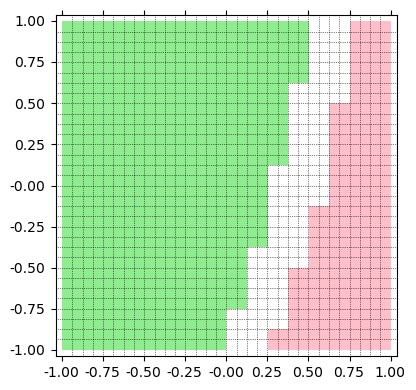

In [55]:
csigv6.plot_histogram2d(5)

In [56]:
csigv6 = F(RIF(0, 5), Q).context_signal_for_system(vf,
    v6, 0, order=6, step=(0.01, 0.5),
    precondition=1,
    estimation=1e-5,
    integrationScheme=2,
    cutoff_threshold=1e-10,
    symbolic_composition=True)
csigv6.signal(0)

phi variables sfs = {x, y}
system sfs = System(R, (x, y), [[0.20000000000000001 .. 0.59999999999999998], [2 .. 3]], (0.29999999999999999?*x^2*y - 0.59999999999999998?*x^2 - 0.2400000000000000?*x*y + 0.59999999999999998?*x, -2*x^2*y + 1.6000000000000001?*x*y - 0.050000000000000003?*y^2 - 0.050000000000000003?*y), varmap=bidict({'x': x, 'y': y}))
Generating Reach Tree: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05a98eb280>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05a98efa40>, print_timings=Fal

 ==> creating ContextSignal with coord=(0,), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05a98eb280>, reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0,), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x < 0.300000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05a98efa40>, print_timings=False, unpreconditioning_order=6, initial_form=<InitialForm.SPLIT_VARS: 3>), reach_tree = <lbuc.reach_trees.ReachTree object at 0x7f05a98e9700>, ctx_mask=None
recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9b14ca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_c

var_names = [b'local_t', b'x', b'y']
res = b'(([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
PolyObserver((([-1.7500000000 , -1.7500000000]) + ([1.0000000000 , 1.0000000000] * y)), <flowstar.reachability.Reach object at 0x7f05a9b14ca0>, (([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y)), symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.0500000001 , -0.0500000000] * y) + ([-0.0500000001 , -0.0500000000] * y^2) + ([1.6000000000 , 1.6000000001] * x * y) + ([-2.0000000000 , -2.0000000000] * x^2 * y))'
fprime = (([-0.0500000001 , -0.

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a9b14ee0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a9b14ee0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 0, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd040>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd040>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.06 seconds
roots = [[3.2925135440525998 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.06 seconds
roots = [[3.2925135440525998 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

top-level root detection: 1 items in 0.06 seconds
roots = [[3.2925135440525998 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[3.2925135440525998 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 

PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd280>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd280>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x *

top-level root detection: 1 items in 0.04 seconds
roots = []
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.9532606920997403e-6 .. 2.9981656117492018], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y < 3.50000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05a98efa40>, print_timings=False, unpreconditioning_order=6, initi

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 1.9532606920997404e-6], [2.9981656117492017 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9532606920997404e-6], 
 [2.9981656117492017 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9532606920997404e-6], 
 [2.9981656117492017 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 2, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.9532606920997403e-6 .. 2.9981656117492018], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd3a0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd3a0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], [1.6227163046949826 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), 

top-level root detection: 1 items in 0.11 seconds
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], [1.6227163046949826 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), 

top-level root detection: 1 items in 0.15 seconds
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], [1.6227163046949826 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.7017867834196229e-6], 
 [1.6227163046949826 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), 

top-level root detection: 1 items in 0.06 seconds
roots = []
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.7017867834196228e-6 .. 1.6227163046949827], False), ([4.6438005650584059 .. 5.0020000000000007], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(0, 3, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05a98eb280>, reach_tree = None, ctx_mask=None
 ==> creating Cont

top-level root detection: 1 items in 0.24 seconds
roots = [[1.1703787204507847 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05

top-level root detection: 1 items in 0.25 seconds
roots = [[1.1703787204507847 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05

top-level root detection: 1 items in 0.24 seconds
roots = [[1.1703787204507847 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05

top-level root detection: 1 items in 0.24 seconds
roots = [[1.1703787204507847 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.1703787204507847 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at 0x7f05

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 0.34455031250000018]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 0.34455031250000018]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 0.34455031250000018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.34455031250000017 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric objec

top-level root detection: 1 items in 0.26 seconds
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], [0.29422187499999985 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], 
 [0.29422187499999985 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], 
 [0.29422187499999985 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([7.3972948427279240e-6 .. 0.29422187499999986], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.21 seconds
roots = [[0.0000000000000000 .. 4.1784001580275563]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 0, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([4.1784001580275562 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 0, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 1.9805664385742392]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 0), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.9805664385742391 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.19 seconds
roots = [[1.8701434062708950 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.8701434062708950 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.8701434062708950 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.34455031250000017 .. 1.8701434062708951], True), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor

top-level root detection: 1 items in 0.20 seconds
roots = [[0.0000000000000000 .. 4.1784001580275563]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([4.1784001580275562 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 1.9805664385742392]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 0), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.9805664385742391 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.09 seconds
roots = [[0.0000000000000000 .. 0.34455031250000018]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 0.34455031250000018]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 0.34455031250000018]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.34455031250000017 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric objec

top-level root detection: 1 items in 0.24 seconds
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], [0.29422187499999985 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], 
 [0.29422187499999985 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 7.3972948427279241e-6], 
 [0.29422187499999985 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 2), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([7.3972948427279240e-6 .. 0.29422187499999986], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 2), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.50000000000000

top-level root detection: 1 items in 0.24 seconds
roots = [[0.0000000000000000 .. 4.1784001580275563]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 2, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([4.1784001580275562 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.12 seconds
roots = [[0.0000000000000000 .. 1.9805664385742392]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 1.9805664385742392]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 0), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([1.9805664385742391 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 0), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

top-level root detection: 1 items in 0.21 seconds
roots = [[1.8701434062708950 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.8701434062708950 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[1.8701434062708950 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.34455031250000017 .. 1.8701434062708951], True), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor

top-level root detection: 1 items in 0.23 seconds
roots = [[0.0000000000000000 .. 4.1784001580275563]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[0.0000000000000000 .. 4.1784001580275563]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(1, 3, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([4.1784001580275562 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(1, 3, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumentor=<flowstar.instrumentation.AggregateMetric object at

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd160>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd160>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd5e0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd5e0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd700>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd700>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd940>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd940>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cd820>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cd820>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cda60>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cda60>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cdb80>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cdb80>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

recomputing reachset
PolyObserver(-x + 0.29999999999999999?, <flowstar.reachability.Reach object at 0x7f05a98cdca0>, -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x, symbolic_composition=True, symbolic_composition_order=6, tentative_unpreconditioning=True, mask=None)
fprime = -0.29999999999999999?*x^2*y + 0.59999999999999998?*x^2 + 0.2400000000000000?*x*y - 0.59999999999999998?*x
setting reach level to 0
var_names = [b'local_t', b'x', b'y']
res = b'(([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x))'
var_names = [b'local_t', b'x', b'y']
res = b'(([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 , 0.2400000001] * x * y) + ([0.5999999999 , 0.6000000000] * x^2) + ([-0.3000000000 , -0.2999999999] * x^2 * y))'
PolyObserver((([0.2999999999 , 0.3000000000]) + ([-1.0000000000 , -1.0000000000] * x)), <flowstar.reachability.Reach object at 0x7f05a98cdca0>, (([-0.6000000000 , -0.5999999999] * x) + ([0.2399999999 

top-level root detection: 1 items in 0.16 seconds
roots = [[2.9890445218882604 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[2.9890445218882604 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[2.9890445218882604 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.0000000000000000 .. 2.9890445218882605], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumento

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.0000000000000000 .. 2.9890445218882605], False), ([3.0600782135205513 .. 5.0020000000000007], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 1), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 2), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05a98eb280>, reach_tree = None, ctx_mask=None
 ==> creating Cont

top-level root detection: 1 items in 0.15 seconds
roots = [[2.9890445218882604 .. 5.0019999999990006]]
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[2.9890445218882604 .. 5.0019999999990006]]
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = [[2.9890445218882604 .. 5.0019999999990006]]
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.0000000000000000 .. 2.9890445218882605], False), ([5.0019999999990005 .. 5.0020000000000007], True)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(x > 0.000000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=True, instrumento

top-level root detection: 1 items in 0.07 seconds
roots = []
domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
seg_domain = [0.0000000000000000 .. 5.0020000000000007]
roots = []
signal given bool roots: 1 items in 0.00 seconds
 ==> creating ContextSignal with coord=(3, 1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [([0.0000000000000000 .. 2.9890445218882605], False), ([3.0600782135205513 .. 5.0020000000000007], False)], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 1, 3), signal = Signal([0.0000000000000000 .. -0.0000000000000000], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 0), signal = <function base_context_signal.<locals>.<lambda> at 0x7f05a98eb280>, reach_tree = None, ctx_mask=None
 ==> creating Cont

var_names = [b'local_t', b'x', b'y']
res = b'(([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))'
fprime = (([0.0500000000 , 0.0500000001] * y) + ([0.0500000000 , 0.0500000001] * y^2) + ([-1.6000000001 , -1.6000000000] * x * y) + ([2.0000000000 , 2.0000000000] * x^2 * y))
=== in signal_fn ===
observer = <flowstar.observers.RestrictedObserver object at 0x7f05a96ef6d0>
 ==> creating ContextSignal with coord=(3, 2, 3), signal = Signal([0.0000000000000000 .. 5.0020000000000007], [], mask=None), reach_tree = None, ctx_mask=None
 ==> creating ContextSignal with coord=(3, 2, 3), signal = functools.partial(<bound method Atomic.signal_fn of Atomic(y > 1.75000000000000)>, precompose_systems=False, order=6, step=(0.0100000000000000, 0.500000000000000), precondition=1, estimation=0.0000100000000000000, integrationScheme=2, cutoff_threshold=1.00000000000000e-10, symbolic_composition=Tru

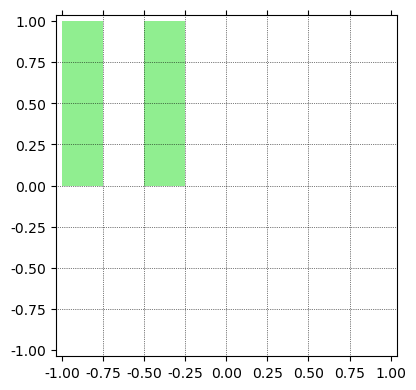

In [57]:
csigv6.plot_histogram2d(3)